In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import pandas as pd
import os
import re
import pyfaidx
import pathlib
import time
from joblib import Parallel

from collections import OrderedDict
from dragonnfruit.preprocessing import *
from dragonnfruit.performance_metrics import pearson_corr, multinomial_log_probs, compute_performance_metrics

import numpy as np
import matplotlib.pyplot as plt
from sklearn.mixture import GaussianMixture
from sklearn.neighbors import NearestNeighbors
from itertools import zip_longest
import collections
from joblib import delayed

import mygene
import pickle
from scipy.sparse import csc_matrix, csr_matrix, coo_matrix

from goatools.base import download_go_basic_obo
from goatools.obo_parser import GODag

import pandas as pd
from sklearn.decomposition import PCA

import gzip
from scipy.spatial.distance import pdist, squareform
from torch.utils.data import DataLoader, Subset, random_split

import pandas as pd
from tqdm import trange


import subprocess

from dragonnfruit.io import *


from bpnetlite.io import one_hot_encode
import hdf5plugin
import h5py
import muon as mu

import torch

from bpnetlite.losses import MNLLLoss
from bpnetlite.losses import log1pMSELoss
from bpnetlite.performance import pearson_corr

from dragonnfruit.models import *
from bpnetlite.logging import Logger

import anndata
import scanpy as sc
import muon as mu

from filelock import FileLock
import optuna

from torch.utils.data import random_split
from bpnetlite.losses import MNLLLoss
from bpnetlite.performance import pearson_corr
import tempfile

import MOODS.scan
import MOODS.tools
import MOODS.parsers
from tqdm import tqdm

import pingouin as pg

from pyjaspar import jaspardb
import pychromvar as pc

from IPython.display import display

from pygenomeviz import GenomeViz, Gff
import pyBigWig

import torch
from torch.utils.data import Dataset
from itertools import product

import sys
import mudata as md

from collections import defaultdict

import dask.dataframe as dd
import dask.array as da

import bz2
import shutil

In [3]:
autocast=False
if torch.is_autocast_enabled():
	print(f"autocast detected, auto-casting model to {dtype}")
	autocast=True

if torch.cuda.is_available() and torch.cuda.is_bf16_supported():
	dtype = torch.bfloat16
	print(f"bfloat16 supported")
else:
	dtype = torch.float16
	print(f"bfloat16 not supported, switching to float16")

dpar = False
device = "cpu"

if torch.cuda.is_available():
	device = "cuda:0"
	if torch.cuda.device_count() > 1:
		print(f"detected {torch.cuda.device_count()} torch devices, using DataParallel")
		dpar=True
	else:
		print(f"detected {torch.cuda.device_count()} torch devices, not using DataParallel")

bfloat16 supported
detected 1 torch devices, not using DataParallel


In [4]:
class RegularizedDynamicBPNetCounts(torch.nn.Module):

	def __init__(self, controller, n_filters=128, n_layers=8, trimming=None, 
		conv_bias=False, n_outputs=1, dropout_rate=0.2):
		super(RegularizedDynamicBPNetCounts, self).__init__()

		self.trimming = trimming if trimming is not None else 2 ** n_layers + 37
		self.n_filters = n_filters
		self.n_layers = n_layers
		self.n_outputs = n_outputs
		self.dropout_rate = dropout_rate
		self.iconv = torch.nn.Conv1d(4, n_filters, kernel_size=21, padding=10)
		self.irelu = torch.nn.ReLU()
		self.idropout = torch.nn.Dropout(p=dropout_rate)
  		
		self.deconv_kernel_size = 75
		self.fconv = torch.nn.Conv1d(self.n_filters, self.n_outputs, kernel_size=self.deconv_kernel_size,
			bias=conv_bias)

		self.biases = torch.nn.ModuleList([
			torch.nn.Linear(controller.n_outputs, n_filters) for i in range(
				n_layers)
		])

		self.convs = torch.nn.ModuleList([
			torch.nn.Conv1d(n_filters, n_filters, kernel_size=3, stride=1, 
				dilation=2**i, padding=2**i, bias=conv_bias) for i in range(1, 
					n_layers+1)
		])

		self.relus = torch.nn.ModuleList([
			torch.nn.ReLU() for i in range(n_layers)
		])

		self.linear = torch.nn.Linear(n_filters, 1)

		self.dropouts = torch.nn.ModuleList([
			torch.nn.Dropout(p=dropout_rate) for _ in range(n_layers)
		])
	   
		self.controller = controller

	def forward(self, X, cell_states):

		start, end = self.trimming, X.shape[2] - self.trimming
		cell_states = self.controller(cell_states)
		X = self.irelu(self.iconv(X))
		X = self.idropout(X)
		for i in range(self.n_layers):
			X_conv = self.convs[i](X)
			X_bias = self.biases[i](cell_states).unsqueeze(-1)			
			X = X + self.relus[i](X_conv + X_bias)
			X = self.dropouts[i](X)

		X = X[:, :, start - self.deconv_kernel_size//2 : end + self.deconv_kernel_size//2]
		y_profile = self.fconv(X)
		X = torch.mean(X, axis=2)
		y_counts = self.linear(X)

		return y_profile, y_counts

In [5]:
def load_torch(config, results_fn, device):
	controller = CellStateController(
			n_inputs=run_config['cell_state_dim'], 
			n_nodes=run_config['ctrl_nodes'], 
			n_layers=run_config['ctrl_layers'], 
			n_outputs=run_config['ctrl_outputs'],
		)
	accessibility_model = RegularizedDynamicBPNetCounts(
			controller=controller,
			n_filters=config['bp_n_filters'], 
			n_layers=config['conv_layers'], 
			trimming=config['trimming'], 
			dropout_rate=config['dropout_rate'], 
			n_outputs=2,
		)

	model = scBPnetCounts(accessibility_model, name=None)

	model_state_dict = torch.load(results_fn)
	model.load_state_dict(model_state_dict)

	model.to(device)

	return model

def get_barcode_map(barcode_path):
	barcode_map = {}
	with open(barcode_path, 'r') as f:
		for i, line in enumerate(f):
			barcode_map[line.strip()] = i
	return barcode_map

def load_signals(data_dir,subset_bcs=None, chroms=None):
	# Initialize the dictionary to store coo_matrix for each chromosome and strand
	chrom_matrices = {'pos':collections.defaultdict(coo_matrix),'neg':collections.defaultdict(coo_matrix)}

	# Pattern to match filenames ending with .pkl or .pkl.bz2
	pattern = r"profile_(chr\d+)_[+-]\.pkl(\.bz2)?"

	for filename in os.listdir(data_dir):
		if filename.startswith('profile_chr') and (filename.endswith('.pkl') or filename.endswith('.pkl.bz2')):
			match = re.match(pattern, filename)
			if match is not None:
				if ((chroms is not None) and (match.group(1) in chroms)) or (chroms is None):
					file_path = os.path.join(data_dir, filename)
					chrom, strand = filename.split('.')[0].split('_')[1:]
					
					if filename.endswith('.pkl.bz2'):
						with bz2.open(file_path, 'rb') as f:
							coo_mat = pickle.load(f)
					else:
						with open(file_path, 'rb') as f:
							coo_mat = pickle.load(f)
					
					csc_mat = coo_mat.tocsc()
					
					if subset_bcs is not None:
						csc_mat = csc_mat[subset_bcs, :]
						
					if strand == '+':
						chrom_matrices['pos'][chrom] = csc_mat
						print(f"{chrom}{strand} min profile value is {csc_mat.min()}, max profile value is {csc_mat.max()}")
					elif strand == '-':
						chrom_matrices['neg'][chrom] = csc_mat
						print(f"{chrom}{strand} min profile value is {csc_mat.min()}, max profile value is {csc_mat.max()}")
					del csc_mat

	return chrom_matrices

def get_read_depths(signals):
    read_depths_pos = []
    read_depths_neg = []
    for chrom_pos, signal_pos in signals['pos'].items():
        read_depths_pos.append(signal_pos.sum(axis=1))
    read_depths_pos = np.concatenate(read_depths_pos,axis=1,dtype=np.int64)
    for chrom_neg, signal_neg in signals['neg'].items():
        read_depths_neg.append(signal_neg.sum(axis=1))
    read_depths_neg = np.concatenate(read_depths_neg,axis=1,dtype=np.int64)

    return {'pos':np.array(read_depths_pos.sum(axis=1)), 'neg':np.array(read_depths_neg.sum(axis=1))}


In [6]:
class scBPnetCounts(DragoNNFruit):
	def __init__(self, accessibility, name, alpha=1, scale_log_rd=False, n_outputs=2):
		torch.nn.Module.__init__(self)
		self.accessibility = accessibility
		self.name = name
		self.alpha = alpha
		self.n_outputs = n_outputs
		self.scale_log_rd = scale_log_rd
		self.logger = Logger(["Epoch", "Iteration", "Training Time",
			"Validation Time", "Training MNLL", "Validation MNLL",
			"Validation Profile Correlation", "Validation Count Correlation", 
			"Saved?"], verbose=True)

	def forward(self, X, cell_states):

		return self.accessibility(X, cell_states)

	def log_softmax(self, y_profile):
		y_profile = y_profile.reshape(y_profile.shape[0], -1)
		y_profile = torch.nn.LogSoftmax(dim=-1)(y_profile)
		y_profile = y_profile.reshape(y_profile.shape[0], self.n_outputs, -1)
		return y_profile
	
	def predict(self, X, cell_states, batch_size=64, logits = False):
		with torch.no_grad():
			starts = np.arange(0, X.shape[0], batch_size)

			ends = starts + batch_size

			y_profiles, y_counts = [], []
			for start, end in zip(starts, ends):
				X_batch = X[start:end]
				cell_states_batch = cell_states[start:end]
				y_profiles_, y_counts_ = self(X_batch,cell_states_batch)
				if not logits:  # apply softmax
					y_profiles_ = self.log_softmax(y_profiles_)
				y_profiles.append(y_profiles_.cpu().detach().numpy())
				y_counts.append(y_counts_.cpu().detach().numpy())

			y_profiles = np.concatenate(y_profiles)
			y_counts = np.concatenate(y_counts)
			return y_profiles, y_counts



In [7]:
prepro_save_dir = f"/workspaces/torch_ddsm/_data_pool1/E-MTAB-10378_postprocessed"

with open(f"{prepro_save_dir}/prepro_config.pkl", 'rb') as f:
	prepro_config = pickle.load(f)
 
run_save_dir = "/workspaces/torch_ddsm/_data_nvme/_torch_save_frag_profile/time.23Aug2024_20.01.21.569115_neighbors.100_window.2048_convlayers.10_ctrl_layers.1_schedMetric.train_jitter.2_trim.512_variant.regularized counts"
save_dir = f"{run_save_dir}/sim_tracks"

# %%
mdata = md.read(prepro_config['results_file'])

signal_bcmap = '/workspaces/torch_ddsm/_data_pool1/E-MTAB-10378_processed/Control1/scafe/count/filtered/matrix/barcodes.tsv'
bcmap = get_barcode_map(signal_bcmap)
mapped_bcs = [bcmap[i] for i in mdata.obs.index]

with open(f"{run_save_dir}/run_config.pkl", 'rb') as f:
	run_config = pickle.load(f)

run_config

# %%
prepro_config

import os
import re

def find_latest_checkpoint(ckpt_dir):
    latest_epoch = -1
    latest_batch = -1
    latest_ckpt_path = None

    # Regular expression to extract epoch and batch numbers
    pattern = re.compile(r"model_e(\d+)_b(\d+)\.pth")

    # Iterate through all files in the checkpoint directory
    for filename in os.listdir(ckpt_dir):
        match = pattern.match(filename)
        if match:
            epoch = int(match.group(1))
            batch = int(match.group(2))

            # Update latest checkpoint if a newer one is found
            if (epoch > latest_epoch) or (epoch == latest_epoch and batch > latest_batch):
                latest_epoch = epoch
                latest_batch = batch
                latest_ckpt_path = os.path.join(ckpt_dir, filename)

    return latest_ckpt_path

ckpt_dir = "/workspaces/torch_ddsm/_data_nvme/_torch_save_frag_profile/time.23Aug2024_20.01.21.569115_neighbors.100_window.2048_convlayers.10_ctrl_layers.1_schedMetric.train_jitter.2_trim.512_variant.regularized counts/ckpt_model/"
latest_checkpoint = find_latest_checkpoint(ckpt_dir)

trained_model = load_torch(run_config,latest_checkpoint, device)

# %%
# chroms = np.unique(mdata['cre'].var['chrom'])
sequences_faidx = pyfaidx.Fasta(prepro_config['genome_ref'])
mapped_chroms = list(sequences_faidx.keys())
target_chroms = [c for c in np.unique(mdata['cre'].var['chrom']) if c in mapped_chroms]
sequences = extract_fasta(filename=prepro_config['genome_ref'], chroms=target_chroms)

# signals = load_signals("/workspaces/torch_ddsm/_data_pool1/E-MTAB-10378_processed/Control1/outs/possorted_genome_bam_cb_subset_profiles_list_1000bp",mapped_bcs)
signals = load_signals("/workspaces/torch_ddsm/_data_pool1/_torch_prepro/E-MTAB-10378_processed/Control1/outs/possorted_genome_bam_cb_subset_profiles_list_10000bp",mapped_bcs,chroms=target_chroms)

# %%
read_depths = get_read_depths(signals)

chr13+ min profile value is 0, max profile value is 161
chr11- min profile value is 0, max profile value is 2110
chr2+ min profile value is 0, max profile value is 1081
chr1- min profile value is 0, max profile value is 907
chr12+ min profile value is 0, max profile value is 519
chr10- min profile value is 0, max profile value is 71
chr3+ min profile value is 0, max profile value is 99
chr2- min profile value is 0, max profile value is 1698
chr11+ min profile value is 0, max profile value is 290
chr13- min profile value is 0, max profile value is 88
chr3- min profile value is 0, max profile value is 228
chr10+ min profile value is 0, max profile value is 130
chr12- min profile value is 0, max profile value is 180
chr1+ min profile value is 0, max profile value is 1544
chr8- min profile value is 0, max profile value is 144
chr17+ min profile value is 0, max profile value is 239
chr22- min profile value is 0, max profile value is 85
chr4- min profile value is 0, max profile value is 625


#### check whether tCREs have bi-directional vs directional coverage at the TSS level (why are all )

In [8]:
mdata['cre'].var

,directionality,orientation,bias_strand,fwd_count,rev_count,chrom,summit_center,abs_summit_diff,oritn_summit_diff,start,...,n_cells_by_counts,mean_counts,pct_dropout_by_counts,total_counts,highly_variable,means,dispersions,dispersions_norm,frag_length,gc_bias
chr1_29236_29737_-,0.000000,unidirectional,-,0,68,chr1,29337,-1,0,29236,...,68,0.017951,98.204857,68.0,False,0.035708,0.799343,-0.712017,501,0.738523
chr1_199774_200275_-,0.021505,divergent,-,2,184,chr1,200006,262,262,199774,...,177,0.048046,95.327350,182.0,False,0.098490,0.913435,-0.315133,501,0.742515
chr1_629102_629950_+,-0.012048,convergent,+,6765,41,chr1,629793,307,-307,629102,...,2715,1.748944,28.326294,6625.0,False,1.550868,1.426006,-0.121210,848,0.417453
chr1_630597_631171_+,0.000383,divergent,+,192997,37,chr1,630948,246,246,630597,...,3766,49.658924,0.580781,188108.0,False,4.682851,3.148479,0.070629,574,0.451220
chr1_632356_633841_+,0.100447,divergent,+,7224,382,chr1,633051,963,963,632356,...,3024,2.062830,20.168955,7814.0,False,1.718540,1.464683,-0.212451,1485,0.426936
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
chrY_21028687_21029188_-,0.000000,unidirectional,-,0,22,chrY,21028788,-1,0,21028687,...,15,0.005016,99.604013,19.0,False,0.010252,1.222718,0.760744,501,0.415170
chrY_21138232_21138733_+,0.043478,divergent,+,90,2,chrY,21138531,204,204,21138232,...,68,0.023231,98.204857,88.0,False,0.040800,0.979056,-0.086863,501,0.379242
chrY_21254335_21254836_+,0.089552,divergent,+,64,3,chrY,21254594,284,284,21254335,...,57,0.017423,98.495248,66.0,False,0.032475,0.960442,-0.151615,501,0.317365
chrY_57067464_57067965_+,0.000000,unidirectional,+,406,0,chrY,57067865,-1,0,57067464,...,356,0.104805,90.601901,397.0,False,0.196913,1.011132,0.024714,501,0.590818


## read in the locus bed file of choice

In [9]:
# scafe outputs the directionality as the BED score and the midpoint of the summit peaks as the BED thickEnd.
# directionality is 0 for unidirectional loci, nonzero for bidirectional loci.
# the sign of the directionality represents either convergent or divergent transcription
# the strand represents the single strand identity of unidirectional loci, or for bidirectional loci, the strand of the peak with the highest score 

bed_file_path = "/workspaces/torch_ddsm/_data_pool1/_torch_prepro/E-MTAB-10378_processed/Control1/scafe/directionality/filtered/bed/filtered.CRE.directionality.summit_center.bed.gz"
column_names = ['chrom', 'start', 'end', 'name', 'directionality', 'strand', None,'midpoint',None, None, None, None]
loci = pd.read_csv(bed_file_path, compression='gzip', header=None, sep='\t')

# Assign column names to the DataFrame
loci.columns = column_names

# Drop columns with None as the name
loci = loci.loc[:, loci.columns.notna()]

loci

,chrom,start,end,name,directionality,strand,midpoint
0,chr1,29236,29737,chr1_29236_29737_-,0.000000,-,29337
1,chr1,199774,200275,chr1_199774_200275_-,0.021505,-,200006
2,chr1,629102,629950,chr1_629102_629950_+,-0.012048,+,629793
3,chr1,630597,631171,chr1_630597_631171_+,0.000383,+,630948
4,chr1,632356,633841,chr1_632356_633841_+,0.100447,+,633051
...,...,...,...,...,...,...,...
17505,chrY,21249513,21250014,chrY_21249513_21250014_-,0.857143,-,21249744
17506,chrY,21254335,21254836,chrY_21254335_21254836_+,0.089552,+,21254594
17507,chrY,57067464,57067965,chrY_57067464_57067965_+,0.000000,+,57067865
17508,chrY,57183815,57184316,chrY_57183815_57184316_+,0.000000,+,57184216


In [10]:
n_pos = loci['directionality'].gt(0).sum()
n_neg = loci['directionality'].lt(0).sum()
n_uni = loci['directionality'].eq(0).sum()
d_ratio = (n_pos+n_neg)/(n_pos+n_neg+n_uni)

print(f"Number of positive directionality loci: {n_pos}, Number of negative directionality loci: {n_neg}, Number of unidirectional loci: {n_uni}, Directionality ratio: {d_ratio}")

Number of positive directionality loci: 8987, Number of negative directionality loci: 628, Number of unidirectional loci: 7895, Directionality ratio: 0.549114791547687


In [11]:
class MappedMultitaskGenerator(torch.utils.data.Dataset):
	def __init__(self, sequence, signal_pos, signal_neg, loci, neighbors, cell_states, cell_labels,
		read_depths_pos, read_depths_neg, trimming, window, chroms,
		max_jitter=128, random_state=None, compute_locus_pbulk=False):
		self.trimming = trimming
		self.window = window
		self.max_jitter = max_jitter
		self.random_state = numpy.random.RandomState(random_state)
		self.neighbors = torch.from_numpy(neighbors)
		self.cell_states = torch.from_numpy(cell_states)
		self.cell_labels = torch.from_numpy(cell_labels)
		self.read_depths_pos = read_depths_pos
		self.read_depths_neg = read_depths_neg
		self.compute_locus_pbulk=compute_locus_pbulk

		chroms_set = set(chroms)
		signal_pos_keys_set = set(signal_pos.keys())
		signal_neg_keys_set = set(signal_neg.keys())

		self.chroms = list(chroms_set & signal_pos_keys_set & signal_neg_keys_set)
		self.signal_pos = {chrom: signal_pos[chrom] for chrom in self.chroms}
		self.signal_neg = {chrom: signal_neg[chrom] for chrom in self.chroms}
  
		self.sequence = {chrom: torch.from_numpy(sequence[chrom]) for chrom in self.chroms}

		loci = loci[numpy.isin(loci['chrom'], self.chroms)]
		self.loci = loci.sort_index().reset_index(drop=True) # interleave
		print(f"random sample cell: {self.random_state.randint(self.cell_states.shape[0])}")

	def __len__(self):
		return self.loci.shape[0]

	def __getitem__(self, locus_idx, debug=False):
		cell_idx = self.random_state.randint(self.cell_states.shape[0])
		locus_row = self.loci.iloc[locus_idx]
					
		return _extract_mapped_multitask_example(self, locus_row.iloc[0], locus_row.iloc[1], locus_row.iloc[2], cell_idx, compute_locus_pbulk=self.compute_locus_pbulk)

class MappedMultitaskDataset(torch.utils.data.Dataset):
	def __init__(self, sequence, signal_pos, signal_neg, loci, neighbors, cell_states, cell_labels,
		read_depths_pos, read_depths_neg, trimming, window, chroms,
		max_jitter=128, random_state=None, compute_locus_pbulk=False):
		self.trimming = trimming
		self.window = window
		self.max_jitter = max_jitter
		self.random_state = numpy.random.RandomState(random_state)
		self.neighbors = torch.from_numpy(neighbors)
		self.cell_states = torch.from_numpy(cell_states)
		self.cell_labels = torch.from_numpy(cell_labels)
		self.read_depths_pos = read_depths_pos
		self.read_depths_neg = read_depths_neg
		self.compute_locus_pbulk=compute_locus_pbulk

		chroms_set = set(chroms)
		signal_pos_keys_set = set(signal_pos.keys())
		signal_neg_keys_set = set(signal_neg.keys())

		self.chroms = list(chroms_set & signal_pos_keys_set & signal_neg_keys_set)
		self.signal_pos = {chrom: signal_pos[chrom] for chrom in self.chroms}
		self.signal_neg = {chrom: signal_neg[chrom] for chrom in self.chroms}
  
		self.sequence = {chrom: torch.from_numpy(sequence[chrom]) for chrom in self.chroms}

		loci = loci[numpy.isin(loci['chrom'], self.chroms)]
		self.loci = loci.sort_index().reset_index(drop=True) # interleave

		self.index_map = {}
		index = 0
		for cell_idx in range(self.cell_states.shape[0]):
			for locus_idx in range(self.loci.shape[0]):
				self.index_map[index] = (cell_idx, locus_idx)
				index += 1
    
	def __len__(self):
		return len(self.index_map)

	def __getitem__(self, idx, debug=False):
		cell_idx, locus_idx = self.index_map[idx]
		locus_row = self.loci.iloc[locus_idx]
					
		return _extract_mapped_multitask_example(self, locus_row.iloc[0], locus_row.iloc[1], locus_row.iloc[2], cell_idx, compute_locus_pbulk=self.compute_locus_pbulk)

def _extract_mapped_multitask_example(self, chrom, start, end, cell_idx, compute_locus_pbulk=False):
	neighbs = self.neighbors[cell_idx]

	midpoint = (start + end) // 2
	half_window = self.window // 2
	new_start = midpoint - half_window
	new_end = midpoint + half_window
	
	# use the endogenous locus
	X = self.sequence[chrom][:, new_start:new_end]
	y_pos = torch.from_numpy(self.signal_pos[chrom][neighbs, new_start+self.trimming:new_end-self.trimming].toarray())
	y_neg = torch.from_numpy(self.signal_neg[chrom][neighbs, new_start+self.trimming:new_end-self.trimming].toarray())
	y = torch.stack((y_pos, y_neg), dim=1) # combine the positive and negative strand signals as a multitask output
	# print(f"y_pos.shape={y_pos.shape}, y_neg.shape={y_neg.shape}, y.shape={y.shape}")
	y = torch.sum(y,dim=0) # get the smoothed profile
	# get the neighborhood average read depth across both strands 
	rt = torch.from_numpy((self.read_depths_pos[neighbs] + self.read_depths_pos[neighbs]).mean(axis=0))
  
	ct = self.cell_states[cell_idx]
	lt = self.cell_labels[cell_idx]
	if compute_locus_pbulk:
		# Compute the locus pseudobulk
		y_pbulk_pos = self.signal_pos[chrom][:, new_start+self.trimming:new_end-self.trimming].toarray()
		y_pbulk_pos = numpy.sum(y_pbulk_pos, axis=0)
		y_pbulk_pos = torch.from_numpy(y_pbulk_pos).unsqueeze(0)

		y_pbulk_neg = self.signal_neg[chrom][:, new_start+self.trimming:new_end-self.trimming].toarray()
		y_pbulk_neg = numpy.sum(y_pbulk_neg, axis=0)
		y_pbulk_neg = torch.from_numpy(y_pbulk_neg).unsqueeze(0)
		y_pbulk = torch.cat((y_pbulk_pos, y_pbulk_neg), dim=0)  # Combine the positive and negative strand signals as a multitask output

		# y_pbulk = y_pbulk_neg
		# breakpoint()
		output_tuple = X, y, y_pbulk, ct, rt, lt, start, end, chrom, cell_idx
	else:
		output_tuple = X, y, ct, rt, lt, start, end, chrom, cell_idx

	return output_tuple

In [12]:
run_config['random_state'] = np.random.RandomState(run_config['rseed'])

read_depths['pos'] = read_depths['pos'][run_config['neighbors']].sum(axis=1)
read_depths['pos'] = np.log2(read_depths['pos'] + 1)
read_depths['pos'] = read_depths['pos'].reshape(-1, 1)

read_depths['neg'] = read_depths['neg'][run_config['neighbors']].sum(axis=1)
read_depths['neg'] = np.log2(read_depths['neg'] + 1)
read_depths['neg'] = read_depths['neg'].reshape(-1, 1)

class LocusGenerator(MappedMultitaskGenerator):
	def __getitem__(self, locus_idx, debug=False):
		cell_idx = self.random_state.randint(self.cell_states.shape[0])
		locus_row = self.loci.iloc[locus_idx]
					
		example_tuple = _extract_mapped_multitask_example(self, locus_row[0], locus_row[1], locus_row[2], cell_idx, compute_locus_pbulk=self.compute_locus_pbulk)
		return example_tuple+(locus_idx,)

# returns: output_tuple = X, y, y_pbulk, ct, rt, lt, start, end, chrom, cell_idx
val_dataset = LocusGenerator(
	sequence=sequences,
	signal_pos=signals['pos'],
	signal_neg=signals['neg'],
	# loci=mdata['cre'].var.loc[:,('chrom','start','end','strand')],
	loci=loci,
	neighbors=run_config['neighbors'],
	cell_states=run_config['cell_states'],
	cell_labels=run_config['cell_labels'],
	read_depths_pos=read_depths['pos'],
	read_depths_neg=read_depths['neg'],
	trimming=run_config['trimming'], 
	window=run_config['window'],
	chroms=target_chroms,
	random_state=0,
	max_jitter=run_config['max_jitter'],
	compute_locus_pbulk=True,
)


# print(f"datasets initialized, deleting signals and sequences...")
# del signals
# del sequences

def window_filter_pbulk(batch):
	# Filter the batch based on the window size
	filtered_batch = [x for x in batch if x[0].shape[1] == run_config['window']]
	
	# Unzip the filtered batch into individual components
	X_batch, y_batch, y_pbulk_batch, c_batch, r_batch, l_batch, start_batch, end_batch, chrom_batch, cell_idx_batch, locus_idx_batch = zip(*filtered_batch)
	
	# Convert tensor components to tensors
	X_batch = torch.stack(X_batch)
	y_batch = torch.stack(y_batch)
	y_pbulk_batch = torch.stack(y_pbulk_batch)
	c_batch = torch.stack(c_batch)
	r_batch = torch.stack(r_batch)
	l_batch = torch.tensor(l_batch)
	start_batch = torch.tensor(start_batch)
	end_batch = torch.tensor(end_batch)
	cell_idx_batch = torch.tensor(cell_idx_batch)
	locus_idx_batch = torch.tensor(locus_idx_batch)
	
	return (
		X_batch,
		y_batch,
		y_pbulk_batch,
		c_batch,
		r_batch,
		l_batch,
		start_batch,
		end_batch,
		list(chrom_batch),  # Keep as list of strings
		cell_idx_batch,
		locus_idx_batch,
	)

val_loader = DataLoader(
	val_dataset, 
	batch_size=16,
	shuffle=False, 
	pin_memory=True,
	collate_fn=window_filter_pbulk,
	num_workers=0)

random sample cell: 2732


In [13]:
def store_chunk(chunk_df, file_name, chunk_id):
	chunk_df.to_parquet(file_name)
	print(f"Chunk {chunk_id} stored with {len(chunk_df)} rows.")

@torch.no_grad()
def infer_profiles(loader, model, profile_cache, df_chunks, chrom_map, chunk_size=10000, verbose=False):
	
	all_chunk_indices = []
	shutil.rmtree(df_chunks, ignore_errors=True)	
	os.makedirs(df_chunks, exist_ok=True)

	columns = [
		'locus_idx',
		'cell_idx',
		'locus_chrom',
		'locus_start',
		'locus_end',
		'obs_label',
		'prof_start',
		'prof_end',
		'profile_loss',
  		'pbulk_profile_loss',
		'y_true',
  		'y_pbulk',
  		'y_pred',
  		'y_pbulk_pred',
	]
	chunk_store = pd.DataFrame(columns=columns)
	chunk_count = 0
	print(f"\n starting inference, writing genomic profile to:\n {profile_cache}")
	model.eval()
	running_val_loss = 0.0
	running_val_profile_loss = 0.0
	running_val_count_loss = 0.0
	val_batch_count = 0

	val_batch_count = 0
	for val_batch in loader:
		print(f"val batch {val_batch_count}")
		X_valid = val_batch[0].float().to(device)
		y_valid = val_batch[1].float().to(device)
		y_pbulk_valid = val_batch[2].float().to(device)
		c_valid = val_batch[3].to(device)
		r_valid = val_batch[4].to(device)
		lb = val_batch[5]
		start = val_batch[6]
		end = val_batch[7]
		prof_start = start.numpy()+run_config['trimming']
		prof_end = prof_start+run_config['window']
		chrom = val_batch[8]
		cell_idx = val_batch[9]
		locus_idx = val_batch[10]

		if autocast:
			with torch.autocast(device_type='cuda', dtype=dtype):
				y_profile, y_counts, = model(X_valid, c_valid)
		else:
			y_profile, y_counts = model(X_valid, c_valid)
   

		y_hat_ = torch.nn.functional.log_softmax(y_profile[:,run_config['debug_strand'],:],dim=-1)
		y_pred_probs = torch.exp(y_hat_) #
		prof_pred = y_pred_probs * y_counts.exp()
		profile_loss_valid = MNLLLoss(y_hat_, y_valid[:,run_config['debug_strand'],:]).mean()
		count_loss_valid = log1pMSELoss(y_counts.reshape(y_counts.shape[0], 1).squeeze(), y_valid[:,run_config['debug_strand'],:].sum(dim=1).reshape(-1, 1).squeeze())

		profile_loss_valid_ = profile_loss_valid.item()
		count_loss_valid_ = count_loss_valid.item()

		loss_valid = profile_loss_valid_ + run_config['counts_alpha'] * count_loss_valid_

		running_val_profile_loss += profile_loss_valid_
		running_val_count_loss += count_loss_valid_
		running_val_loss += profile_loss_valid_ + run_config['counts_alpha'] * count_loss_valid_

		y_profile = y_hat_.unsqueeze(1).unsqueeze(3)
		y_counts = y_counts.unsqueeze(1)

		y_valid_flat = y_valid[:,run_config['debug_strand'],:]
		y_valid = y_valid_flat.unsqueeze(1).unsqueeze(3)
		y_valid_counts = y_valid.sum(dim=2)

		measures = compute_performance_metrics(y_valid.cpu().numpy(), y_profile.cpu().numpy(),y_valid_counts.cpu().numpy(), y_counts.exp().cpu().numpy(), 7, 81)

		y_pbulk_valid_flat = y_pbulk_valid[:,run_config['debug_strand'],:]
		y_pbulk_valid_counts = y_pbulk_valid_flat.sum(dim=1).unsqueeze(1)
		y_pbulk_valid_norm = y_pbulk_valid_flat / (y_pbulk_valid_counts+ np.finfo(np.float32).tiny)
		y_pbulk_valid = torch.log(y_pbulk_valid_norm + np.finfo(np.float32).tiny)
		y_pbulk_pred_probs = torch.exp(y_pbulk_valid)
		pbulk_prof_pred = y_pbulk_valid_norm * y_valid_flat.sum(dim=1).unsqueeze(1)

		y_pbulk_valid = y_pbulk_valid.unsqueeze(1).unsqueeze(3)
		y_pbulk_valid_counts = y_pbulk_valid.sum(dim=2)

		measures_pbulk = compute_performance_metrics(y_valid.cpu().numpy(), y_pbulk_valid.cpu().numpy(),y_valid_counts.cpu().numpy(), y_valid_counts.cpu().numpy(), 7, 81)
		val_batch_count += 1

		# prof_corrs.extend(profile_corr.cpu().numpy())
		# chunk_store = pd.concat([chunk_store, batch_df], ignore_index=True)
		chunk_data = {
			'locus_idx': locus_idx.cpu().numpy(),
			'cell_idx': cell_idx.cpu().numpy(),
			'locus_chrom': np.vectorize(chrom_map.get)(np.array(chrom)),
			'locus_start': start.cpu().numpy(),
			'locus_end': end.cpu().numpy(),
			'obs_label': lb.cpu().numpy(),
			'prof_start': prof_start,
			'prof_end': prof_end,
			'profile_loss': measures['nll'].squeeze(),
			'pbulk_profile_loss': measures_pbulk['nll'].squeeze(),
			'count_loss': measures['count_mse'].squeeze(),
			'pbulk_count_loss': measures_pbulk['count_mse'].squeeze(),
			'profile_div': measures['jsd'].squeeze(),
			'pbulk_profile_div': measures_pbulk['jsd'].squeeze(),
			'y_true': y_valid_flat.tolist(),
			'y_pbulk': y_pbulk_valid_flat.tolist(),
			'y_pred': prof_pred.tolist(),
			'y_pbulk_pred': pbulk_prof_pred.tolist(),
			'y_pbulk_pred_probs': y_pbulk_valid_norm.tolist(),
		}
		chunk_dtypes = {
			'locus_idx': 'int32',
			'cell_idx': 'int32',
			'locus_chrom': 'int32',
			'locus_start': 'int32',
			'locus_end': 'int32',
			'obs_label': 'int32',
			'prof_start': 'int32',
			'prof_end': 'int32',
			'profile_loss': 'float32',
			'pbulk_profile_loss': 'float32',
			'profile_div': 'float32',
			'pbulk_profile_div': 'float32',
			'count_loss': 'float32',
			'pbulk_count_loss': 'float32',
		}
		chunk_df = pd.DataFrame(chunk_data)
		chunk_df = chunk_df.astype(chunk_dtypes)

		chunk_store = pd.concat([chunk_store, chunk_df], ignore_index=True)
		chunk_store = chunk_store.astype(chunk_dtypes)
		# Check if the chunk store has reached the chunk size limit
		if len(chunk_store) >= chunk_size:
			chunk_count += 1
			chunk_store['chunk_index'] = chunk_store.index.astype(str)+"_"+str(chunk_count)
			print(f"chunk store reached {len(chunk_store)} rows, storing chunk {chunk_count}")
			print(f"chunk columns: {chunk_store.columns}")
			store_chunk(chunk_store, f"{df_chunks}/chunk_{chunk_count}.parquet", chunk_count)
			all_chunk_indices.extend(np.unique(chunk_store['chunk_index']))
			print(f"number of unique indices in chunk store: {len(np.unique(all_chunk_indices))}")
			chunk_store = pd.DataFrame(columns=columns)
	if len(chunk_store) > 0:
		chunk_count += 1
		chunk_store['chunk_index'] = chunk_store.index.astype(str)+"_"+str(chunk_count)
		print(f"storing remaining chunk {chunk_count}")
		print(f"chunk columns: {chunk_store.columns}")
		store_chunk(chunk_store, f"{df_chunks}/chunk_{chunk_count}.parquet", chunk_count)
		all_chunk_indices.extend(np.unique(chunk_store['chunk_index']))
		print(f"number of unique indices in chunk store: {len(np.unique(all_chunk_indices))}")

In [14]:
len(val_loader.dataset)

16921

#### map strings to int so we can have everything numeric, otherwise we cant have dask partitions

In [15]:
strand_map = {'+':0, '-':1}
chrom_map = {chrom:idx for idx,chrom in enumerate(sequences.keys())}

reverse_chrom_map = {idx: chrom for chrom, idx in chrom_map.items()}
reverse_strand_map = {idx: strand for strand, idx in strand_map.items()}

In [16]:
run_config.keys()

dict_keys(['n_neighbors_sc', 'ctrl_nodes', 'ctrl_outputs', 'ctrl_layers', 'bp_n_filters', 'fragstart', 'window', 'counts_alpha', 'conv_layers', 'trimming', 'max_jitter', 'prepro_save_dir', 'cell_labels', 'results_file_multi', 'chrom_sizes', 'frag_fn', 'rseed', 'lr', 'debug_strand', 'sched_metric', 'sched_patience', 'sched_factor', 'sched_thresh', 'dtype', 'dpar', 'train_batch_size', 'val_batch_size', 'cell_state_dim', 'dropout_rate', 'max_epochs', 'validation_freq', 'subset_chroms', 'train_chroms', 'test_chroms', 'bc_file', 'signals_dir', 'validation_step_unit', 'model_variant', 'save_dir', 'model_ckpts', 'opt_ckpts', 'cell_states', 'neighbors', 'random_state', 'wandb_run_id', 'wandb_run_url'])

In [17]:
f"{save_dir}/df_chunks_val_chr5"

'/workspaces/torch_ddsm/_data_nvme/_torch_save_frag_profile/time.23Aug2024_20.01.21.569115_neighbors.100_window.2048_convlayers.10_ctrl_layers.1_schedMetric.train_jitter.2_trim.512_variant.regularized counts/sim_tracks/df_chunks_val_chr5'

In [18]:
infer_profiles(
    val_loader, 
    trained_model, 
    profile_cache=f"{save_dir}/val_profiles_chr5.h5", 
    df_chunks=f"{save_dir}/df_chunks_val_chr5", 
    chrom_map=chrom_map)


 starting inference, writing genomic profile to:
 /workspaces/torch_ddsm/_data_nvme/_torch_save_frag_profile/time.23Aug2024_20.01.21.569115_neighbors.100_window.2048_convlayers.10_ctrl_layers.1_schedMetric.train_jitter.2_trim.512_variant.regularized counts/sim_tracks/val_profiles_chr5.h5
val batch 0
val batch 1
val batch 2
val batch 3
val batch 4
val batch 5
val batch 6
val batch 7
val batch 8
val batch 9
val batch 10
val batch 11
val batch 12
val batch 13
val batch 14
val batch 15
val batch 16
val batch 17
val batch 18
val batch 19
val batch 20
val batch 21
val batch 22
val batch 23
val batch 24
val batch 25
val batch 26
val batch 27
val batch 28
val batch 29
val batch 30
val batch 31
val batch 32
val batch 33
val batch 34
val batch 35
val batch 36
val batch 37
val batch 38
val batch 39
val batch 40
val batch 41
val batch 42
val batch 43
val batch 44
val batch 45
val batch 46
val batch 47
val batch 48
val batch 49
val batch 50
val batch 51
val batch 52
val batch 53
val batch 54
val b

In [19]:
df_val = dd.read_parquet(f"{save_dir}/df_chunks_val_chr5",index='chunk_index')
df_val.head()

,locus_idx,cell_idx,locus_chrom,locus_start,locus_end,obs_label,prof_start,prof_end,profile_loss,pbulk_profile_loss,y_true,y_pbulk,y_pred,y_pbulk_pred,count_loss,pbulk_count_loss,profile_div,pbulk_profile_div,y_pbulk_pred_probs
chunk_index,,,,,,,,,,,,,,,,,,,
0_1,0,2607,0,29236,29737,3,29748,31796,0.0000,0.0000,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[1.6484564542770386, 1.775873064994812, 1.6117...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",1.453852e+10,3.641274e+12,NaN,NaN,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
1_1,1,1653,0,199774,200275,4,200286,202334,0.0000,0.0000,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.2847002148628235, 0.2653532326221466, 0.274...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",1.453852e+10,3.641274e+12,NaN,NaN,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
2_1,2,835,0,629102,629950,0,629614,631662,4631.6250,1931.7500,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.10509730875492096, 0.13938462734222412, 0.1...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",1.453852e+10,3.641274e+12,0.005606,0.001886,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
3_1,3,763,0,630597,631171,3,631109,633157,533676.0000,4116.0000,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[1.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.04150544852018356, 0.04606659337878227, 0.0...","[0.02747455984354019, 0.02747455984354019, 0.0...",1.453852e+10,3.641274e+12,0.016306,0.005045,"[3.600050035856839e-09, 3.600050035856839e-09,..."
4_1,4,1731,0,632356,633841,5,632868,634916,12560.3125,6491.4375,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[143.0, 143.0, 143.0, 143.0, 143.0, 143.0, 143...","[21.8834171295166, 22.048540115356445, 25.5426...","[4.110097885131836, 4.110097885131836, 4.11009...",1.453852e+10,3.641274e+12,0.069843,0.031927,"[0.00010068833944387734, 0.0001006883394438773..."


<Figure size 1000x600 with 0 Axes>

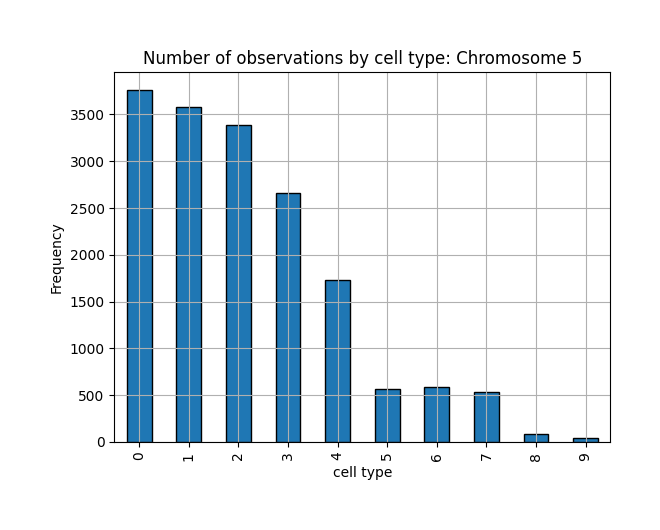

<Figure size 640x480 with 0 Axes>

In [20]:
import matplotlib.pyplot as plt
import dask.dataframe as dd

# Assuming df_val is your Dask DataFrame and it contains a column named 'obs_label'
# Compute the value counts
obs_label_counts = df_val['obs_label'].value_counts().compute()

# Convert to a Pandas DataFrame for plotting
obs_label_counts_df = obs_label_counts.reset_index()
obs_label_counts_df.columns = ['obs_label', 'count']

# Plot the histogram
plt.figure(figsize=(10, 6))
obs_label_counts_df.plot(kind='bar', x='obs_label', y='count', edgecolor='black', legend=False)


plt.title('Number of observations by cell type: Chromosome 5')
plt.xlabel('cell type')
plt.ylabel('Frequency')
plt.grid(True)
plt.show()
plt.savefig(f"{save_dir}/obs_by_celltype_chr5.pdf")

In [21]:
def plot_data_point(seq_df, rev_chrom_map, idx,normalize=True, plot_true=True, plot_pred=True, plot_pbulk=False, plot_diff=True, plot_overlaps=True):
	# Example NumPy vectors for predicted values
	values_pred = np.array(seq_df['y_pred'].compute()[idx])
	values_pbulk = np.array(seq_df['y_pbulk_pred'].compute()[idx])
	values_true = np.array(seq_df['y_true'].compute()[idx])

	if normalize:
		values_pred = values_pred / np.sum(values_pred)
		values_true = values_true / np.sum(values_true)
		values_pbulk = values_pbulk / np.sum(values_pbulk)

	pos_pred = np.arange(len(values_pred))  # x-axis positions for the vector
	pos_pbulk = np.arange(len(values_pbulk))  # x-axis positions for the vector
	pos_true = np.arange(len(values_true))  # x-axis positions for the vector

	# Plot the data points
	plt.figure(figsize=(12, 8))

	if plot_pred:
		if run_config['debug_strand'] == 0:
			# Plot the top half of predicted values above the x-axis
			plt.plot(pos_pred, values_pred, '-', label='predicted strand 0', markersize=8, color='blue')
			plt.fill_between(pos_pred, values_pred, color='blue', alpha=0.3)

		elif run_config['debug_strand'] == 1:
			# Plot the bottom half of predicted values below the x-axis
			plt.plot(pos_pred, -values_pred, '-', label='predicted strand 1', markersize=8, color='red')
			plt.fill_between(pos_pred, -values_pred, color='red', alpha=0.3)

	if plot_true:
		if run_config['debug_strand'] == 0:
			# Plot the top half of true values above the x-axis
			plt.plot(pos_true, values_true, '--', label='true strand 0', markersize=8, color='green')
			plt.fill_between(pos_true, values_true, color='green', alpha=0.3)

		elif run_config['debug_strand'] == 1:
			# Plot the bottom half of true values below the x-axis
			plt.plot(pos_true, -values_true, '--', label='true strand 1', markersize=8, color='orange')
			plt.fill_between(pos_true, -values_true, color='orange', alpha=0.3)

	if plot_pbulk:
		if run_config['debug_strand'] == 0:
			# Plot the top half of predicted values above the x-axis
			plt.plot(pos_pbulk, values_pbulk, '-', label='pbulk strand 0', markersize=8, color='purple')
			plt.fill_between(pos_pbulk, values_pbulk, color='purple', alpha=0.3)

		elif run_config['debug_strand'] == 1:
			# Plot the bottom half of predicted values below the x-axis
			plt.plot(pos_pbulk, -values_pbulk, '-', label='pbulk strand 1', markersize=8, color='pink')
			plt.fill_between(pos_pbulk, -values_pbulk, color='pink', alpha=0.3)


	# Add titles and labels
	plt.xlabel('Position')
	plt.ylabel('normalized profile')
	plt.title(f"{rev_chrom_map[seq_df['locus_chrom'].compute()[idx].item()]}:{seq_df['locus_start'].compute()[idx].item()}-{seq_df['locus_end'].compute()[idx].item()}, "
				f"label:{seq_df['obs_label'].compute()[idx].item()}, "
				f"cell idx:{seq_df['cell_idx'].compute()[idx].item()}, "
				f"locus idx:{seq_df['locus_idx'].compute()[idx]}\n "
				f"debug strand: {run_config['debug_strand']}")	
	plt.legend()
	# Display the plot
	plt.show()

	return values_pred, values_pbulk, values_true


In [22]:
import numpy as np
import matplotlib.pyplot as plt

def plot_locus(seq_df, rev_chrom_map, locus_idx, normalize=True, plot_true=True, plot_pred=True, plot_pbulk=False, plot_diff=True, plot_overlaps=True):
	# Filter rows in seq_df where column locus_idx matches parameter locus_idx
	filtered_df = seq_df[seq_df['locus_idx'] == locus_idx].compute()

	for idx in range(len(filtered_df)):
		values_pred = np.array(filtered_df['y_pred'][idx])
		values_true = np.array(filtered_df['y_true'][idx])
		values_pbulk = np.array(filtered_df['y_pbulk_pred'][idx])

		if normalize:
			values_pred = values_pred / np.sum(values_pred)
			values_true = values_true / np.sum(values_true)
			values_pbulk = values_pbulk / np.sum(values_pbulk)

		pos_pred = np.arange(len(values_pred))  # x-axis positions for the vector
		pos_true = np.arange(len(values_true))  # x-axis positions for the vector
		pos_pbulk = np.arange(len(values_pbulk))  # x-axis positions for the vector

		# Plot the data points
		plt.figure(figsize=(12, 8))

		if plot_pred:
			if run_config['debug_strand'] == 0:
				# Plot the top half of predicted values above the x-axis
				plt.plot(pos_pred, values_pred, '-', label='predicted strand 0', markersize=8, color='blue')
				plt.fill_between(pos_pred, values_pred, color='blue', alpha=0.3)
			elif run_config['debug_strand'] == 1:
				# Plot the bottom half of predicted values below the x-axis
				plt.plot(pos_pred, -values_pred, '-', label='predicted strand 1', markersize=8, color='red')
				plt.fill_between(pos_pred, -values_pred, color='red', alpha=0.3)

		if plot_true:
			if run_config['debug_strand'] == 0:
				# Plot the top half of true values above the x-axis
				plt.plot(pos_true, values_true, '--', label='true strand 0', markersize=8, color='green')
				plt.fill_between(pos_true, values_true, color='green', alpha=0.3)
			elif run_config['debug_strand'] == 1:
				# Plot the bottom half of true values below the x-axis
				plt.plot(pos_true, -values_true, '--', label='true strand 1', markersize=8, color='orange')
				plt.fill_between(pos_true, -values_true, color='orange', alpha=0.3)

		if plot_pbulk:
			if run_config['debug_strand'] == 0:
				# Plot the top half of predicted values above the x-axis
				plt.plot(pos_pbulk, values_pbulk, '-', label='pbulk strand 0', markersize=8, color='purple')
				plt.fill_between(pos_pbulk, values_pbulk, color='purple', alpha=0.3)

			elif run_config['debug_strand'] == 1:
				# Plot the bottom half of predicted values below the x-axis
				plt.plot(pos_pbulk, -values_pbulk, '-', label='pbulk strand 1', markersize=8, color='pink')
				plt.fill_between(pos_pbulk, -values_pbulk, color='pink', alpha=0.3)


		# Add titles and labels
		plt.xlabel('Position')
		plt.ylabel('normalized profile')
		plt.title(f"{rev_chrom_map[filtered_df['locus_chrom'][idx].item()]}:{filtered_df['locus_start'][idx].item()}-{filtered_df['locus_end'][idx].item()}, "
				  f"label:{filtered_df['obs_label'][idx].item()}, "
				  f"cell idx:{filtered_df['cell_idx'][idx].item()}, "
				  f"locus idx:{filtered_df['locus_idx'][idx].item()}\n "
				  f"debug strand: {run_config['debug_strand']}")
		plt.legend()

		# Display the plot
		plt.show()


In [23]:
import numpy as np
import matplotlib.pyplot as plt

def plot_locus_by_coords(seq_df, chrom_map, rev_chrom_map, locus_chrom, locus_start, locus_end, normalize=True, plot_true=True, plot_pred=True, plot_diff=True, plot_overlaps=True):
    # Filter rows in seq_df where column locus_idx matches parameter locus_idx
    filtered_df = seq_df.query(f"locus_chrom == {chrom_map[locus_chrom]} & locus_start == {locus_start} & locus_end == {locus_end}").compute()

    for idx in range(len(filtered_df)):
        values_pred = np.array(filtered_df['y_pred'][idx])
        values_true = np.array(filtered_df['y_true'][idx])

        if normalize:
            values_pred = values_pred / np.sum(values_pred)
            values_true = values_true / np.sum(values_true)

        pos_pred = np.arange(len(values_pred))  # x-axis positions for the vector
        pos_true = np.arange(len(values_true))  # x-axis positions for the vector

        # Plot the data points
        plt.figure(figsize=(12, 8))

        if plot_pred:
            if run_config['debug_strand'] == 0:
                # Plot the top half of predicted values above the x-axis
                plt.plot(pos_pred, values_pred, '-', label='predicted strand 0', markersize=8, color='blue')
                plt.fill_between(pos_pred, values_pred, color='blue', alpha=0.3)
            elif run_config['debug_strand'] == 1:
                # Plot the bottom half of predicted values below the x-axis
                plt.plot(pos_pred, -values_pred, '-', label='predicted strand 1', markersize=8, color='red')
                plt.fill_between(pos_pred, -values_pred, color='red', alpha=0.3)

        if plot_true:
            if run_config['debug_strand'] == 0:
                # Plot the top half of true values above the x-axis
                plt.plot(pos_true, values_true, '--', label='true strand 0', markersize=8, color='green')
                plt.fill_between(pos_true, values_true, color='green', alpha=0.3)
            elif run_config['debug_strand'] == 1:
                # Plot the bottom half of true values below the x-axis
                plt.plot(pos_true, -values_true, '--', label='true strand 1', markersize=8, color='orange')
                plt.fill_between(pos_true, -values_true, color='orange', alpha=0.3)

        # Add titles and labels
        plt.xlabel('Position')
        plt.ylabel('normalized profile')
        plt.title(f"{rev_chrom_map[filtered_df['locus_chrom'][idx].item()]}:{filtered_df['locus_start'][idx].item()}-{filtered_df['locus_end'][idx].item()}, "
                  f"label:{filtered_df['obs_label'][idx].item()}, "
                  f"cell idx:{filtered_df['cell_idx'][idx].item()}, "
                  f"locus idx:{filtered_df['locus_idx'][idx].item()}\n "
                  f"debug strand: {run_config['debug_strand']}")
        plt.legend()

        # Display the plot
        plt.show()


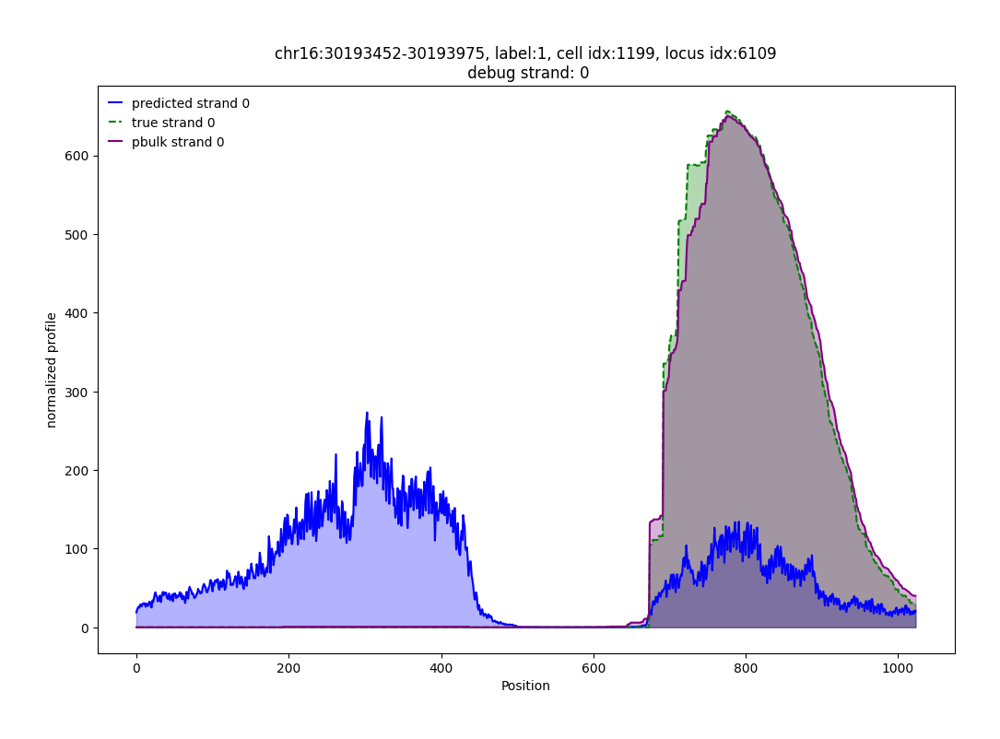

In [24]:
y_sums = np.array([np.sum(i) for i in df_val['y_true'].compute()])
directionality = [val_dataset.loci['directionality'][i] for i in df_val['locus_idx'].compute()]
scaled_directionality = y_sums * directionality
max_directionality_locus = df_val.index.compute()[np.argmax(scaled_directionality)]
values_pred, values_pbulk, values_true = plot_data_point(df_val,reverse_chrom_map, max_directionality_locus, plot_true=True, plot_pbulk=True,plot_pred=True,plot_overlaps=False, normalize=False)

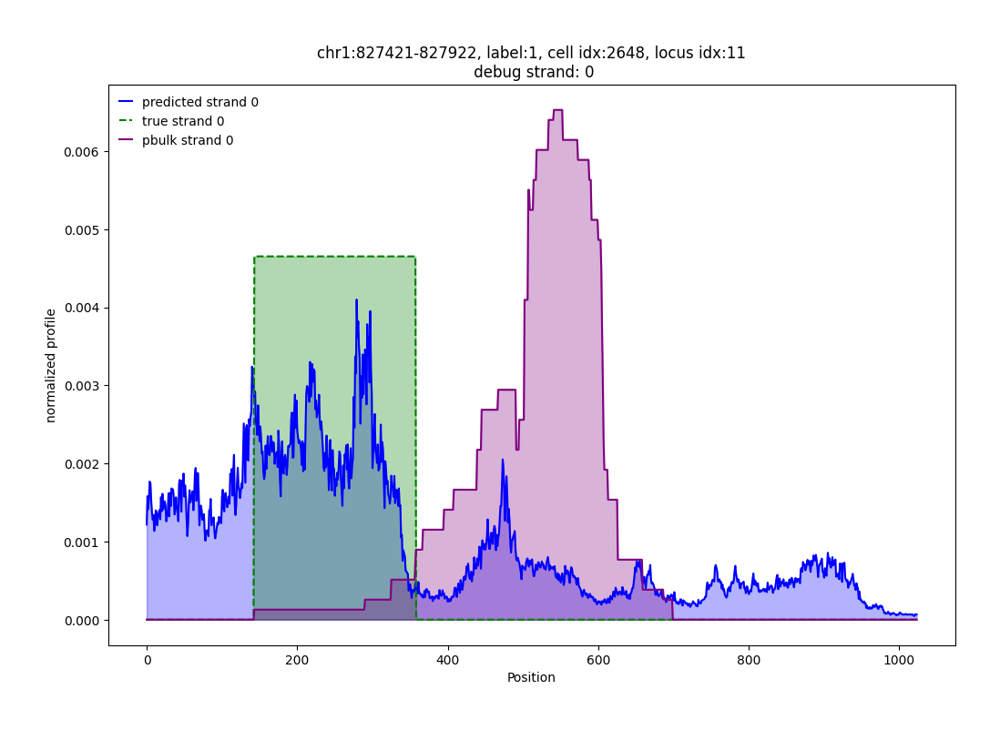

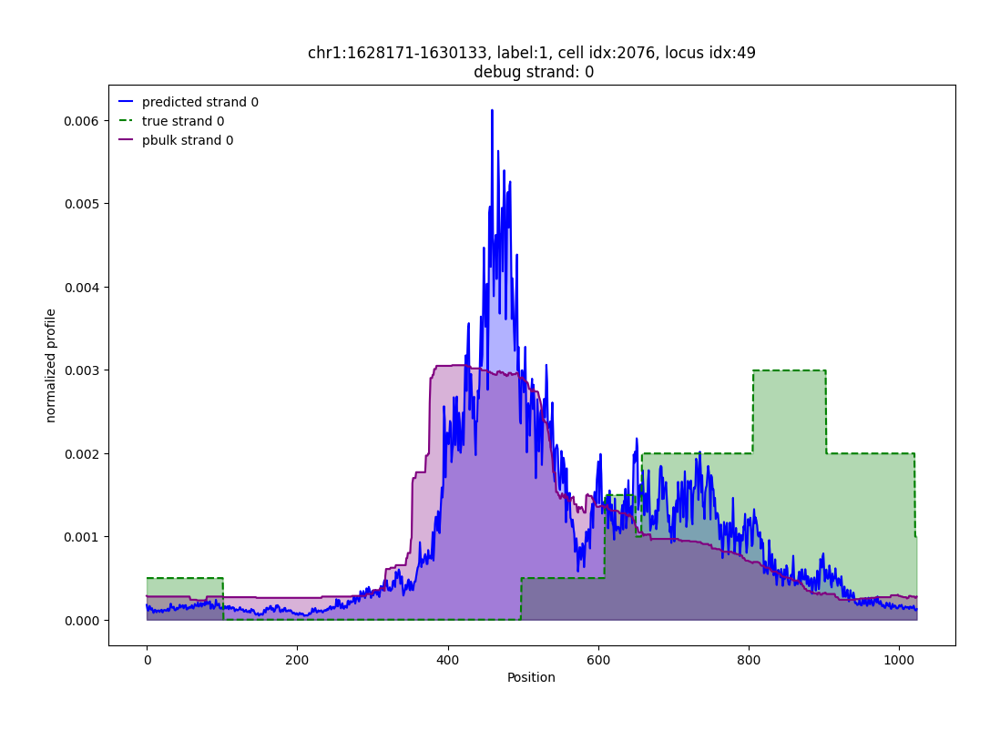

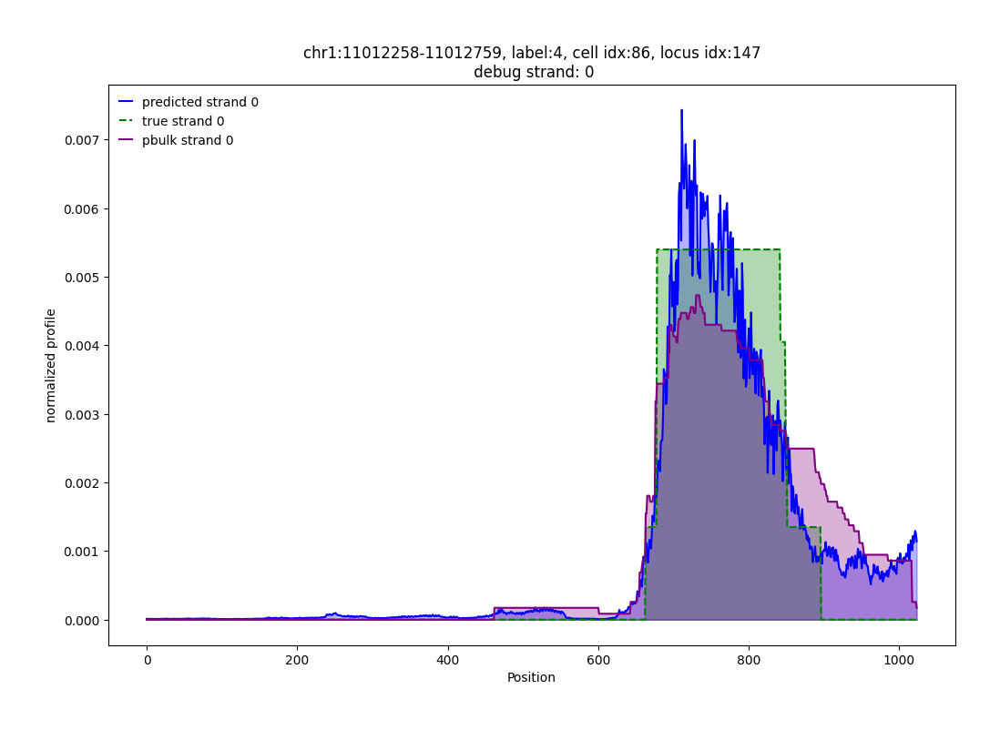

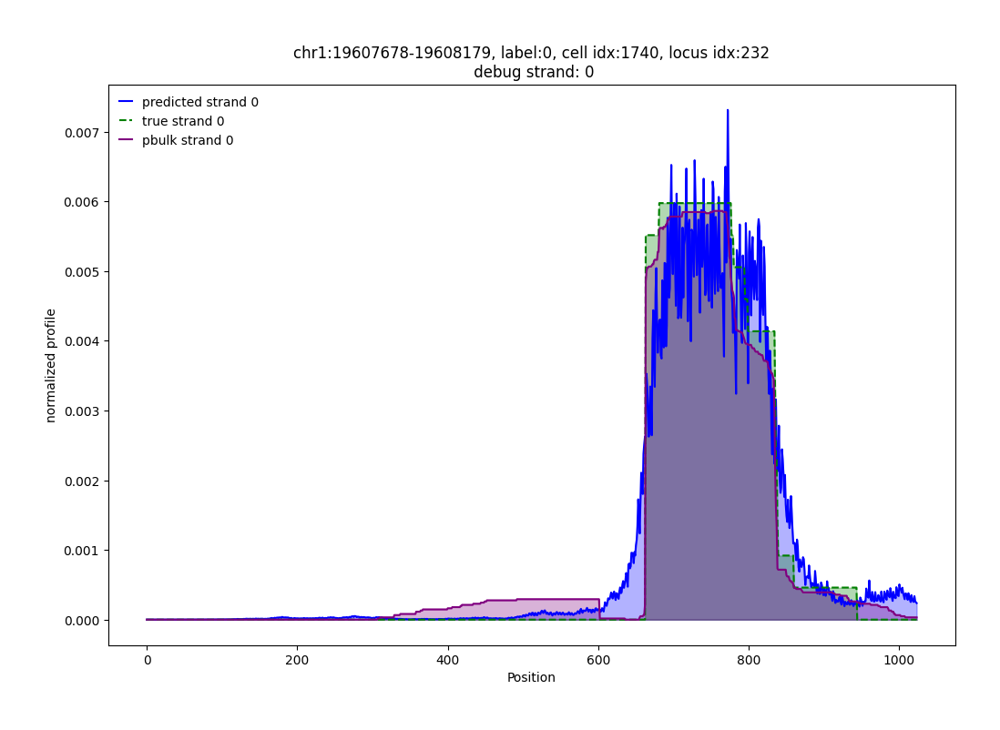

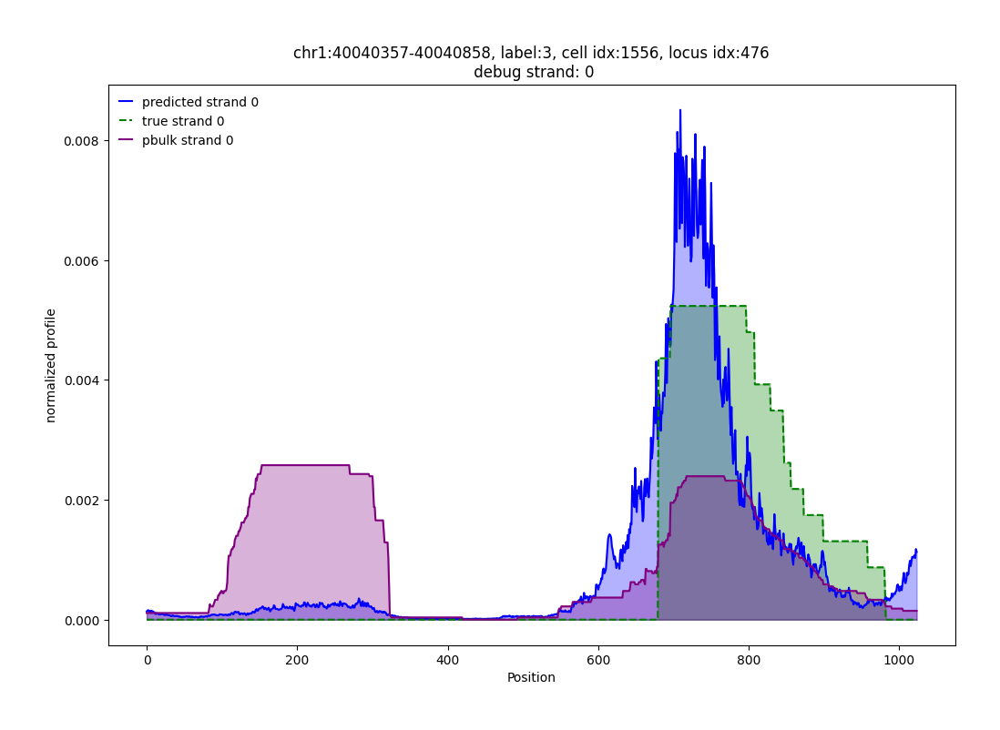

...

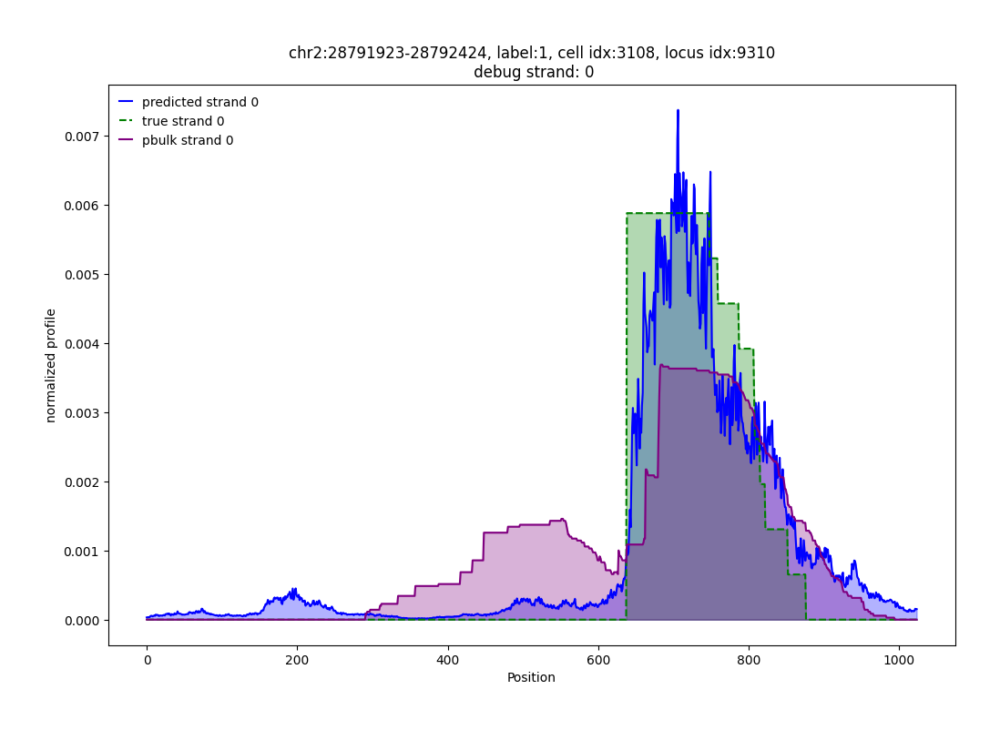

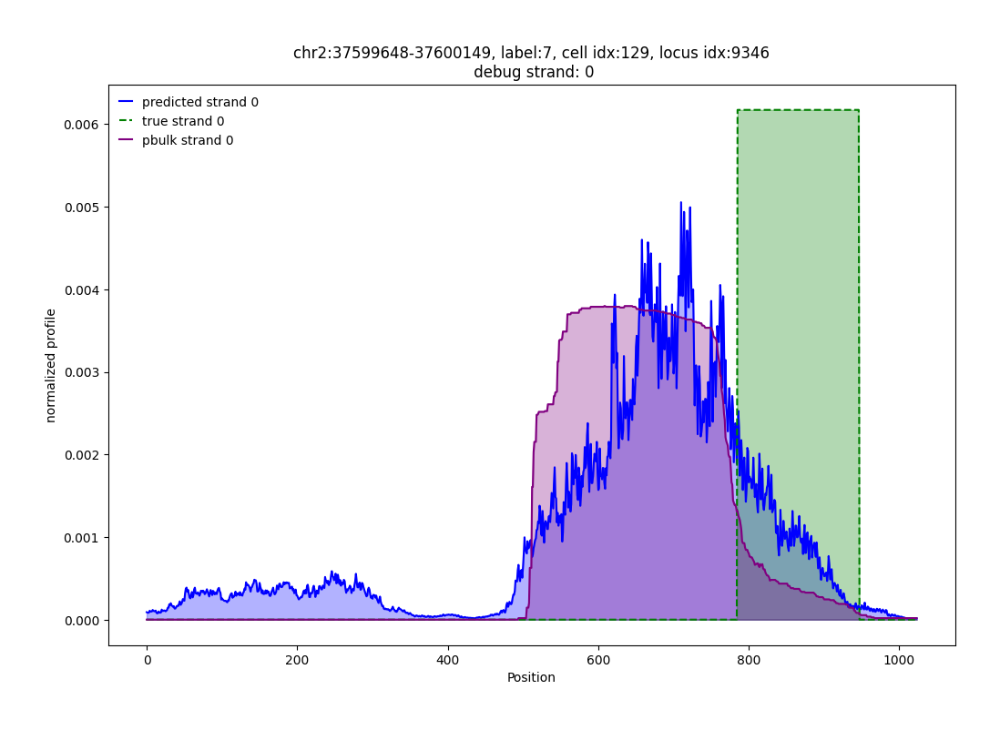

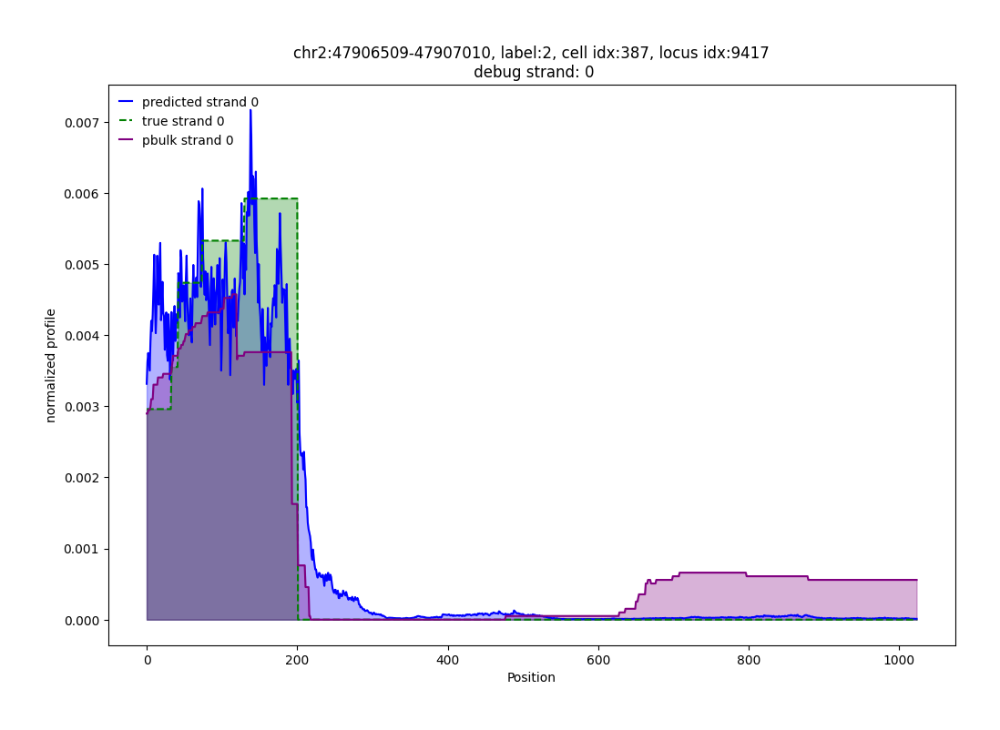

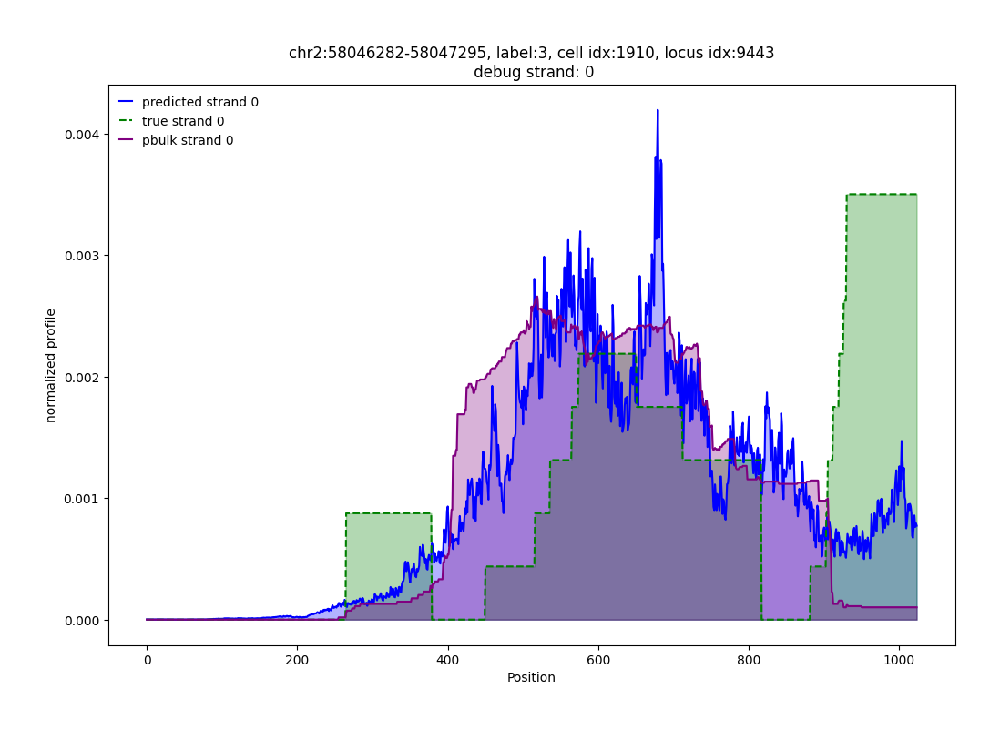

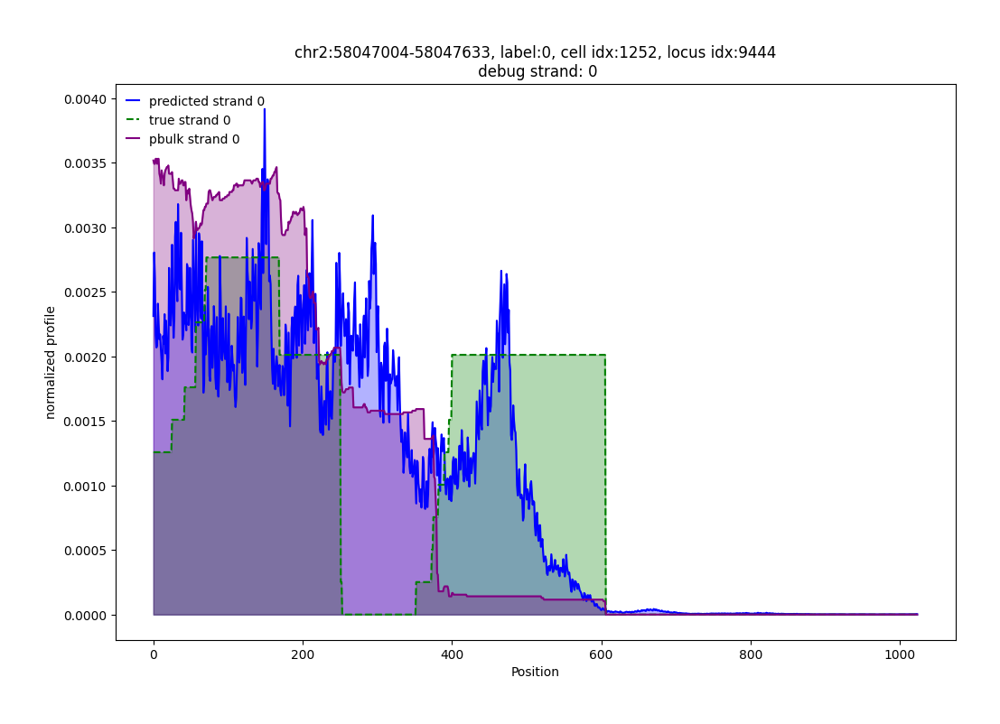

KeyboardInterrupt: 

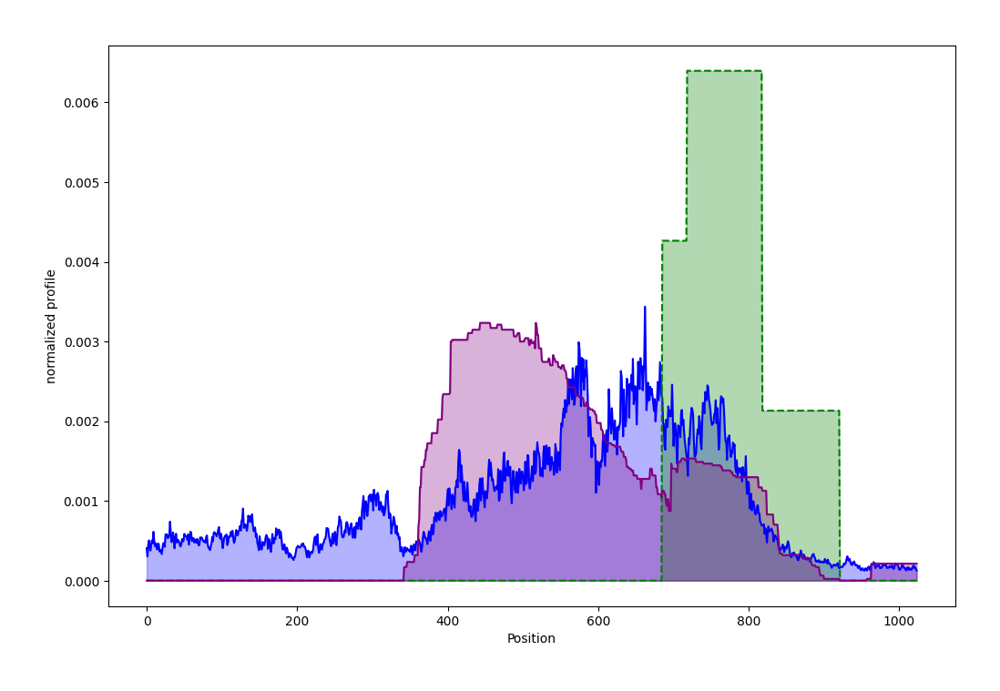

In [25]:
best_div = df_val.query(f"pbulk_profile_div > profile_div").compute()

for idx in range(len(best_div)):
    plot_data_point(df_val,reverse_chrom_map, best_div.index[idx], plot_true=True,plot_overlaps=False,normalize=True, plot_pbulk=True)

In [26]:
best_div.head(1)

,locus_idx,cell_idx,locus_chrom,locus_start,locus_end,obs_label,prof_start,prof_end,profile_loss,pbulk_profile_loss,y_true,y_pbulk,y_pred,y_pbulk_pred,count_loss,pbulk_count_loss,profile_div,pbulk_profile_div,y_pbulk_pred_probs
chunk_index,,,,,,,,,,,,,,,,,,,
11_1,11,2648,0,827421,827922,1,827933,829981,396.986755,913.484192,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.4463661015033722, 0.5795595645904541, 0.518...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",1.453852e+10,3.641274e+12,0.234338,0.596927,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."


In [27]:
best_div.shape

(449, 19)

In [28]:
def make_track_values_dict(all_values, coords, chrom):
    track_values = defaultdict(lambda : [])

    for values, (coord_chrom, start, end) in zip(all_values, coords):
        # subset to only peaks/values for the chromosome we're looking at now
        if coord_chrom == chrom:
            assert len(values) == end - start, (len(values), start, end, end - start)
            
            for position, value in enumerate(values):
                position_offset = position + start
                track_values[position_offset] = track_values[position_offset] + [value]
    
    # take the mean at each position, so that if there was ovelap, the average value is used
    track_values = { key : sum(vals) / len(vals) for key, vals in track_values.items() }
    return track_values


def write_tracks_to_bigwigs(values,
                            coords,
                            chrom_sizes,
                            save_filepath_prefix):
    
    print("Writing predicted profiles to bigwigs.")
    print("Save prefix: " + save_filepath_prefix)
    
    assert len(coords) == len(values)
    
    for strand_idx, strand in enumerate(["+", "-"]):
        # write separate bigwigs for svalues on the forward vs. reverse strands (in case of overlap)
        if strand == "+":
            bw_filename = save_filepath_prefix + ".pos.bigWig"
        else:
            bw_filename = save_filepath_prefix + ".neg.bigWig"
        
        values_for_strand = [vals[strand_idx] for vals in values]

        # bigwigs need to be written in order -- so we have to go chromosome by chromosome,
        # and the chromosomes need to be numerically sorted (i.e. chr9 then chr10)
        chrom_names = chrom_sizes.keys()
        chrom_order = {chrom : i for i, chrom in enumerate(chrom_names)}        
        chromosomes = sorted(list({reverse_chrom_map[coord[0]] for coord in coords}), key=lambda chrom_str, co=chrom_order: co[chrom_str])
        bw = pyBigWig.open(bw_filename, 'w')
        # bigwigs need headers before they can be written to
        # the header is just the info you'd find in a chrom.sizes file
        chrom_tuples = []
        for key, value in chrom_sizes.items():
            chrom_tuples.append((key, value))
        bw.addHeader(chrom_tuples)
        
        for chrom in chromosomes:
            # convert arrays of scores for each peak into dict of base position : score
            # this function will average together scores at the same position from different called peaks
            track_values_dict = make_track_values_dict(values_for_strand, coords, chrom)
            num_entries = len(track_values_dict)
            
            starts = sorted(list(track_values_dict.keys()))
            ends = [position + 1 for position in starts]
            values_to_write = [track_values_dict[key] for key in starts]
            
            assert len(values_to_write) == len(starts) and len(values_to_write) == len(ends)
            
            bw.addEntries([chrom for _ in range(num_entries)], 
                           starts, ends = ends, values = values_to_write)
    
        bw.close()

In [97]:
import re

from collections import defaultdict

def make_track_values_dict(all_values, coords, chrom, interval=30):
    track_values = defaultdict(lambda : [])

    for values, (coord_chrom, start, end) in zip(all_values, coords):
        # Subset to only peaks/values for the chromosome we're looking at now
        if coord_chrom == chrom:
            assert len(values) == end - start, (len(values), start, end, end - start)
            
            for position, value in enumerate(values):
                position_offset = position + start
                track_values[position_offset] = track_values[position_offset] + [value]
    
    # Take the mean at each position, so that if there was overlap, the average value is used
    track_values = { key : sum(vals) / len(vals) for key, vals in track_values.items() }
    
    # Now apply smoothing by discretizing the profile into chunks of size `interval`
    smoothed_track_values = {}
    sorted_positions = sorted(track_values.keys())

    for i in range(0, len(sorted_positions), interval):
        # Define the start and end of the chunk
        chunk_positions = sorted_positions[i:i + interval]
        
        # Collect all values within the chunk
        chunk_values = [track_values[pos] for pos in chunk_positions]
        
        # Compute the average value over the chunk
        if chunk_values:  # Ensure there are values in the chunk
            smoothed_value = sum(chunk_values) / len(chunk_values)
            
            # Assign the smoothed value to each position in the chunk
            for pos in chunk_positions:
                smoothed_track_values[pos] = smoothed_value
    
    return smoothed_track_values

from collections import defaultdict

def make_track_values_dict(all_values, coords, chrom, interval=30):
    track_values = defaultdict(lambda : [])

    for values, (coord_chrom, start, end) in zip(all_values, coords):
        # Subset to only peaks/values for the chromosome we're looking at now
        if coord_chrom == chrom:
            assert len(values) == end - start, (len(values), start, end, end - start)
            
            for position, value in enumerate(values):
                position_offset = position + start
                track_values[position_offset] = track_values[position_offset] + [value]
    
    # Take the mean at each position, so that if there was overlap, the average value is used
    track_values = { key : sum(vals) / len(vals) for key, vals in track_values.items() }
    
    # Now apply smoothing by discretizing the profile into chunks of size `interval`
    smoothed_track_values = {}
    sorted_positions = sorted(track_values.keys())

    for i in range(0, len(sorted_positions), interval):
        # Define the start and end of the chunk
        chunk_positions = sorted_positions[i:i + interval]
        
        # Compute the midpoint of the chunk
        if chunk_positions:  # Ensure there are positions in the chunk
            midpoint = chunk_positions[len(chunk_positions) // 2]
            
            # Collect all values within the chunk
            chunk_values = [track_values[pos] for pos in chunk_positions]
            
            # Compute the average value over the chunk
            smoothed_value = sum(chunk_values) / len(chunk_values)
            
            # Assign the smoothed value to the midpoint position
            smoothed_track_values[midpoint] = smoothed_value
    
    return smoothed_track_values

# Function to split chromosome names into numeric and non-numeric parts
def natural_key(chrom_str):
    return [int(text) if text.isdigit() else text for text in re.split(r'(\d+)', chrom_str)]

# Now, sort the chromosome names using the natural_key


myloci = []
mycoords = []
for row in best_div.itertuples():
    mylocus = collections.defaultdict()
    mylocus[run_config['debug_strand']] = row.y_pred
    myloci.append(mylocus)    
    mycoords.append((reverse_chrom_map[row.locus_chrom],row.prof_start+run_config['trimming'],row.prof_end-run_config['trimming']))

values = myloci
coords = mycoords
chrom_sizes = run_config['chrom_sizes']
save_filepath_prefix = f"{save_dir}"

assert len(coords) == len(values)

for strand_idx, strand in enumerate(["+"]):
    print(f"enumerating chroms for strand {strand}")
    # write separate bigwigs for svalues on the forward vs. reverse strands (in case of overlap)
               
    values_for_strand = [vals[strand_idx] for vals in values]
        
    # bigwigs need to be written in order -- so we have to go chromosome by chromosome,
    # and the chromosomes need to be numerically sorted (i.e. chr9 then chr10)
    chrom_names = chrom_sizes.keys()
    chrom_order = {chrom : i for i, chrom in enumerate(chrom_names)}
    # chromosomes = sorted(list({reverse_chrom_map[coord[0]] for coord in coords}), key=lambda chrom_str, co=chrom_order: co[chrom_str])
    chromosomes = sorted(list({coord[0] for coord in coords}), key=natural_key)
    
    for chrom in chromosomes:
        # convert arrays of scores for each peak into dict of base position : score
        # this function will average together scores at the same position from different called peaks
        if strand == "+":
            bg_filename = save_filepath_prefix + "_" + chrom + ".pos.bedgraph"
        else:
            bg_filename = save_filepath_prefix + "_" + chrom + ".neg.bedgraph"

        track_interval=1
        track_values_dict = make_track_values_dict(values_for_strand, coords, chrom, interval=track_interval)
        num_entries = len(track_values_dict)

        starts = [s-track_interval//2 for s in sorted(list(track_values_dict.keys()))]
        ends = [position + track_interval for position in starts]
        values_to_write = [track_values_dict[key] for key in track_values_dict.keys()]
        
        # starts = sorted([i-track_interval//2 for i in list(track_values_dict.keys())])
        # ends = sorted([i+track_interval//2 for i in list(track_values_dict.keys())])
        # values_to_write = [track_values_dict[key] for key in [s-track_interval//2 for s in starts]]
        
        assert len(values_to_write) == len(starts) and len(values_to_write) == len(ends)
        print(f"smoothing values for {chrom}...")
        print(f"max/min profile value = {np.max(values_to_write)}/{np.min(values_to_write)}")
        values_to_write_scaled=(values_to_write-np.min(values_to_write))/(np.max(values_to_write)-np.min(values_to_write))
        print(f"max/min profile value = {np.max(values_to_write_scaled)}/{np.min(values_to_write_scaled)}")

        df = pd.DataFrame({
            'chrom': [chrom for _ in range(num_entries)],
            'start': [str(k) for k in starts],
            'end': [str(k) for k in ends],
            'value': [str(k) for k in values_to_write_scaled]
        })
        print(f"saving tracks for {chrom} to\n {bg_filename}")
        df.to_csv(bg_filename, index=False,header=False, sep=' ')

enumerating chroms for strand +
smoothing values for chr1...
max/min profile value = 212.1790313720703/2.351702732994454e-06
max/min profile value = 1.0/0.0
saving tracks for chr1 to
 /workspaces/torch_ddsm/_data_nvme/_torch_save_frag_profile/time.23Aug2024_20.01.21.569115_neighbors.100_window.2048_convlayers.10_ctrl_layers.1_schedMetric.train_jitter.2_trim.512_variant.regularized counts/sim_tracks_chr1.pos.bedgraph
smoothing values for chr2...
max/min profile value = 244.2893829345703/1.224193702366096e-18
max/min profile value = 1.0/0.0
saving tracks for chr2 to
 /workspaces/torch_ddsm/_data_nvme/_torch_save_frag_profile/time.23Aug2024_20.01.21.569115_neighbors.100_window.2048_convlayers.10_ctrl_layers.1_schedMetric.train_jitter.2_trim.512_variant.regularized counts/sim_tracks_chr2.pos.bedgraph
smoothing values for chr3...
max/min profile value = 172.43701171875/2.485458207956981e-05
max/min profile value = 1.0/0.0
saving tracks for chr3 to
 /workspaces/torch_ddsm/_data_nvme/_torch_s

KeyError: 1

In [96]:
np.unique([c[0] for c in coords])

array(['chr1', 'chr10', 'chr11', 'chr12', 'chr13', 'chr14', 'chr15',
       'chr16', 'chr17', 'chr18', 'chr19', 'chr2', 'chr20', 'chr21',
       'chr22', 'chr3', 'chr4', 'chr5', 'chr6', 'chr7', 'chr8', 'chr9'],
      dtype='<U5')

In [55]:
len(myloci)

449

In [52]:
run_config['debug_strand']

0

In [31]:
mycoords, myloci

([('chr1', 828445, 829469),
  ('chr1', 1629195, 1630219),
  ('chr1', 11013282, 11014306),
  ('chr1', 19608702, 19609726),
  ('chr1', 40041381, 40042405),
  ('chr1', 40041388, 40042412),
  ('chr1', 42501338, 42502362),
  ('chr1', 42818260, 42819284),
  ('chr1', 59297717, 59298741),
  ('chr1', 84575275, 84576299),
  ('chr1', 84997844, 84998868),
  ('chr1', 89633771, 89634795),
  ('chr1', 89633844, 89634868),
  ('chr1', 93180395, 93181419),
  ('chr1', 109484582, 109485606),
  ('chr1', 120913323, 120914347),
  ('chr1', 144462560, 144463584),
  ('chr1', 145608640, 145609664),
  ('chr1', 147173402, 147174426),
  ('chr1', 148459356, 148460380),
  ('chr1', 149637191, 149638215),
  ('chr1', 149637582, 149638606),
  ('chr1', 149647488, 149648512),
  ('chr1', 149928726, 149929750),
  ('chr1', 150926825, 150927849),
  ('chr1', 151071384, 151072408),
  ('chr1', 153775916, 153776940),
  ('chr1', 155136676, 155137700),
  ('chr1', 155689242, 155690266),
  ('chr1', 161133369, 161134393),
  ('chr1', 170

In [ ]:
values_to_write_scaled=(values_to_write-np.min(values_to_write))/(np.max(values_to_write)-np.min(values_to_write))

In [ ]:
len(values_to_write_scaled),len(values_to_write)

(39085, 39085)

In [ ]:
run_config['chrom_sizes']

{'chr1': 248956422,
 'chr10': 133797422,
 'chr11': 135086622,
 'chr12': 133275309,
 'chr13': 114364328,
 'chr14': 107043718,
 'chr15': 101991189,
 'chr16': 90338345,
 'chr17': 83257441,
 'chr18': 80373285,
 'chr19': 58617616,
 'chr2': 242193529,
 'chr20': 64444167,
 'chr21': 46709983,
 'chr22': 50818468,
 'chr3': 198295559,
 'chr4': 190214555,
 'chr5': 181538259,
 'chr6': 170805979,
 'chr7': 159345973,
 'chr8': 145138636,
 'chr9': 138394717,
 'chrM': 16569,
 'chrX': 156040895,
 'chrY': 57227415}

In [ ]:
df = pd.DataFrame({
    'chrom': [chrom for _ in range(num_entries)],
    'start': [str(k) for k in starts],
    'end': [str(k) for k in ends],
    'value': [str(k) for k in values_to_write_scaled]
})
df.to_csv(f"{save_dir}/chr10+.bedgraph", index=False,header=False)

In [ ]:
f"{save_dir}/chr10+.bedgraph"

'/workspaces/torch_ddsm/_data_nvme/_torch_save_frag_profile/time.23Aug2024_20.01.21.569115_neighbors.100_window.2048_convlayers.10_ctrl_layers.1_schedMetric.train_jitter.2_trim.512_variant.regularized counts/sim_tracks/chr10+.bedgraph'

In [ ]:
myloci = []
mycoords = []
for row in best_div.itertuples():
    mylocus = collections.defaultdict()
    mylocus[run_config['debug_strand']] = row.y_pred
    myloci.append(mylocus)
    
    mycoords.append((row.locus_chrom,row.locus_start,row.locus_end))

write_tracks_to_bigwigs(myloci,
                        mycoords,
                        run_config['chrom_sizes'],
                        save_dir)

Writing predicted profiles to bigwigs.
Save prefix: /workspaces/torch_ddsm/_data_nvme/_torch_save_frag_profile/time.23Aug2024_20.01.21.569115_neighbors.100_window.2048_convlayers.10_ctrl_layers.1_schedMetric.train_jitter.2_trim.512_variant.regularized counts/sim_tracks


RuntimeError: The entries you tried to add are out of order, precede already added entries, or otherwise use illegal values.
 Please correct this and try again.


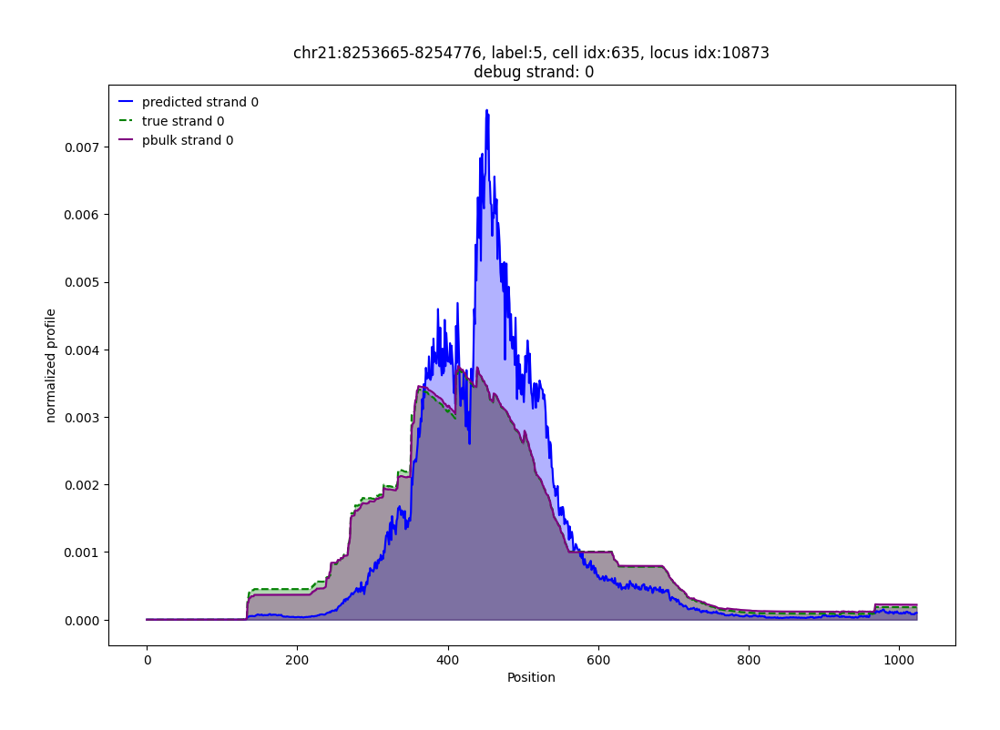

(array([3.30464537e-08, 3.99240267e-08, 3.50042781e-08, ...,
        9.77854448e-05, 9.69280936e-05, 1.02081749e-04]),
 array([1.04106087e-08, 1.04106087e-08, 1.04106087e-08, ...,
        2.20442542e-04, 2.20308259e-04, 2.20167720e-04]),
 array([0.        , 0.        , 0.        , ..., 0.00018318, 0.00018303,
        0.00018288]))

In [ ]:
min_prof_loss = df_val.index.compute()[np.argmax(df_val['profile_loss'].compute())]

plot_data_point(df_val,reverse_chrom_map, min_prof_loss, plot_true=True,plot_overlaps=False,normalize=True, plot_pbulk=True)

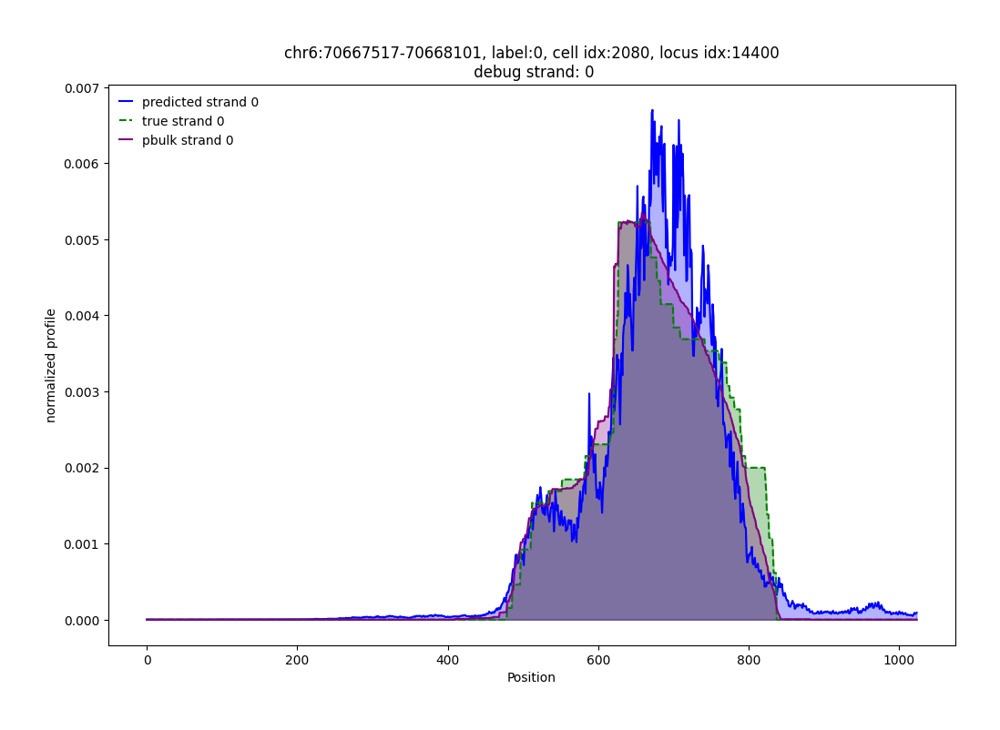

(array([8.51229216e-07, 9.35468537e-07, 9.59349130e-07, ...,
        7.42966771e-05, 8.21163488e-05, 9.20003396e-05]),
 array([0., 0., 0., ..., 0., 0., 0.]),
 array([0., 0., 0., ..., 0., 0., 0.]))

In [ ]:
min_loss = df_val.index.compute()[np.argmax(df_val['profile_loss'].compute() + run_config['counts_alpha']*df_val['count_loss'].compute())]

plot_data_point(df_val,reverse_chrom_map, min_loss, plot_true=True,plot_overlaps=False,normalize=True, plot_pbulk=True)

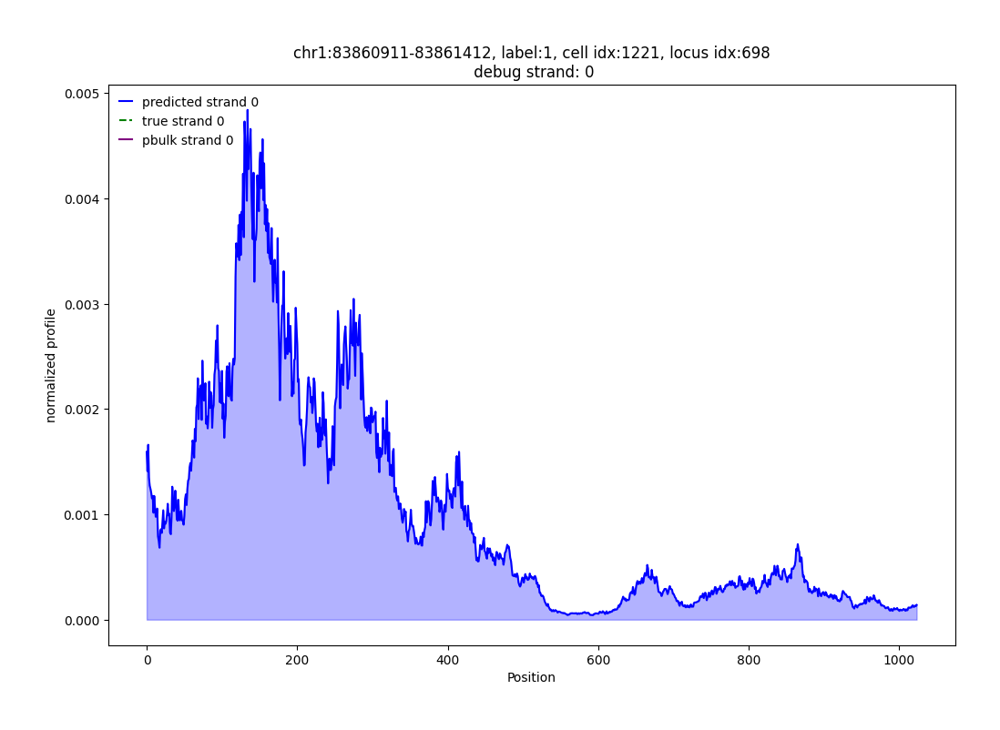

In [ ]:
plot_locus(df_val,reverse_chrom_map, 698, plot_true=True,plot_overlaps=False,normalize=True, plot_pbulk=True)

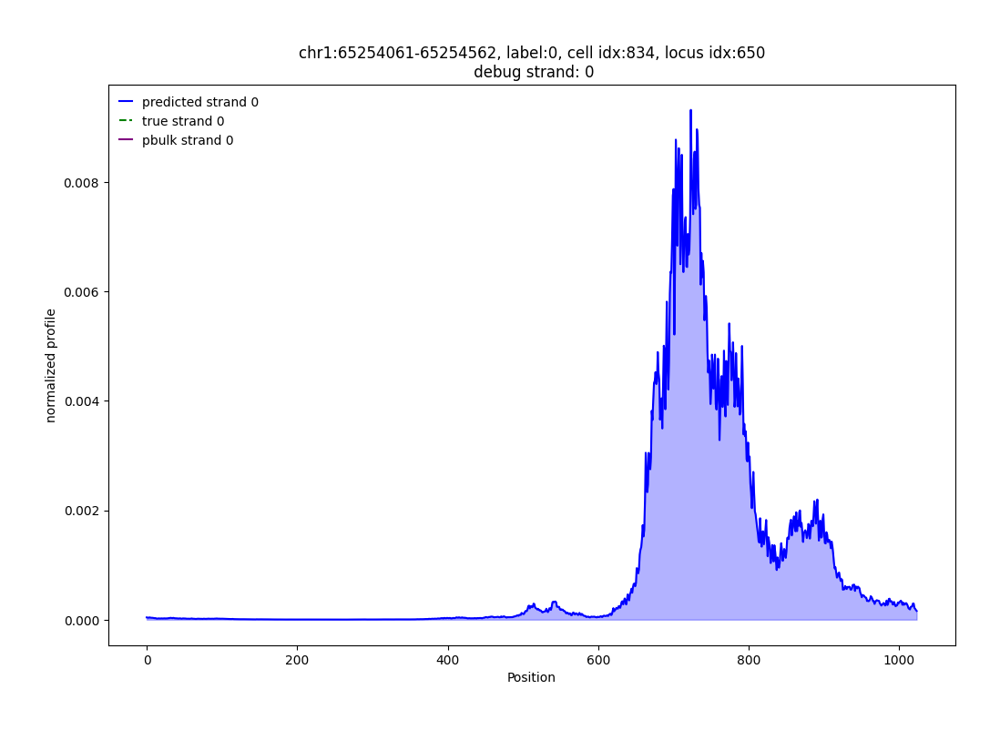

In [ ]:
plot_locus(df_val, reverse_chrom_map, 650, plot_true=True,plot_overlaps=False,normalize=True,plot_pbulk=True)

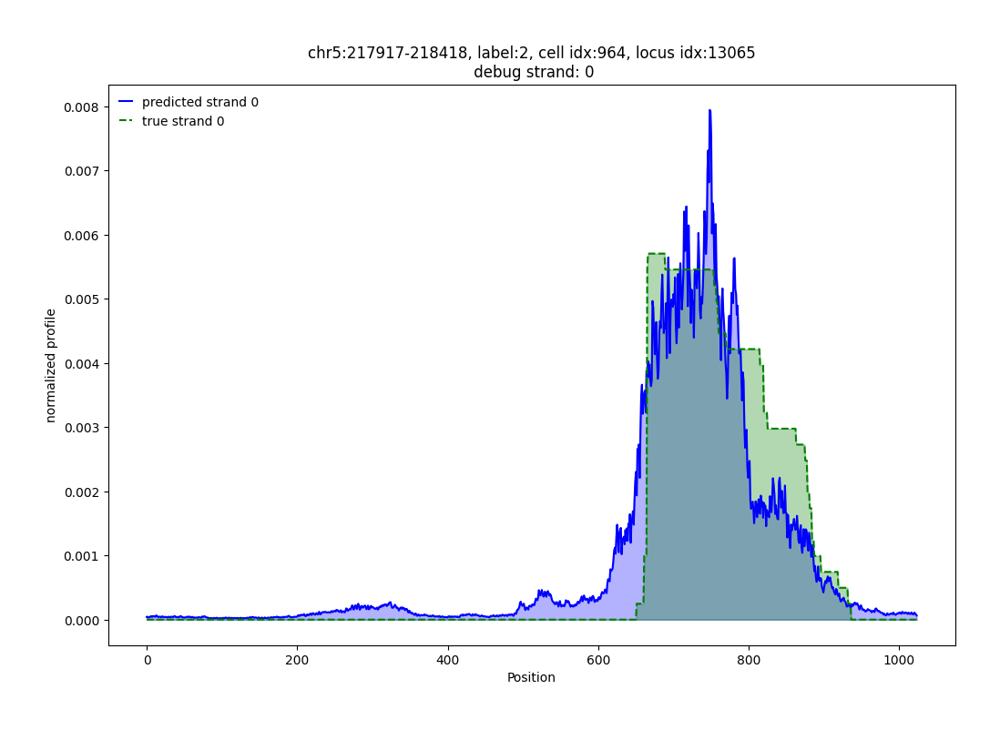

In [ ]:
plot_locus_by_coords(df_val, chrom_map, reverse_chrom_map, locus_chrom='chr5', locus_start=217917, locus_end=218418, plot_true=True,plot_overlaps=False,normalize=True)

Mann-Whitney U test pbulk vs 0: U-statistic=4946287.0, p-value=6.158e-02
Mann-Whitney U test pbulk vs 3: U-statistic=3541923.0, p-value=9.044e-02
Mann-Whitney U test pbulk vs 5: U-statistic=735220.0, p-value=3.323e-01
Mann-Whitney U test pbulk vs 1: U-statistic=4357744.0, p-value=9.637e-02
Mann-Whitney U test pbulk vs 4: U-statistic=2385481.0, p-value=4.881e-01
Mann-Whitney U test pbulk vs 2: U-statistic=4327732.0, p-value=6.024e-02
Mann-Whitney U test pbulk vs 7: U-statistic=652520.0, p-value=6.001e-04
Mann-Whitney U test pbulk vs 6: U-statistic=757642.0, p-value=1.256e-01
Mann-Whitney U test pbulk vs 9: U-statistic=57316.0, p-value=1.339e-01
Mann-Whitney U test pbulk vs 8: U-statistic=115942.0, p-value=6.544e-01


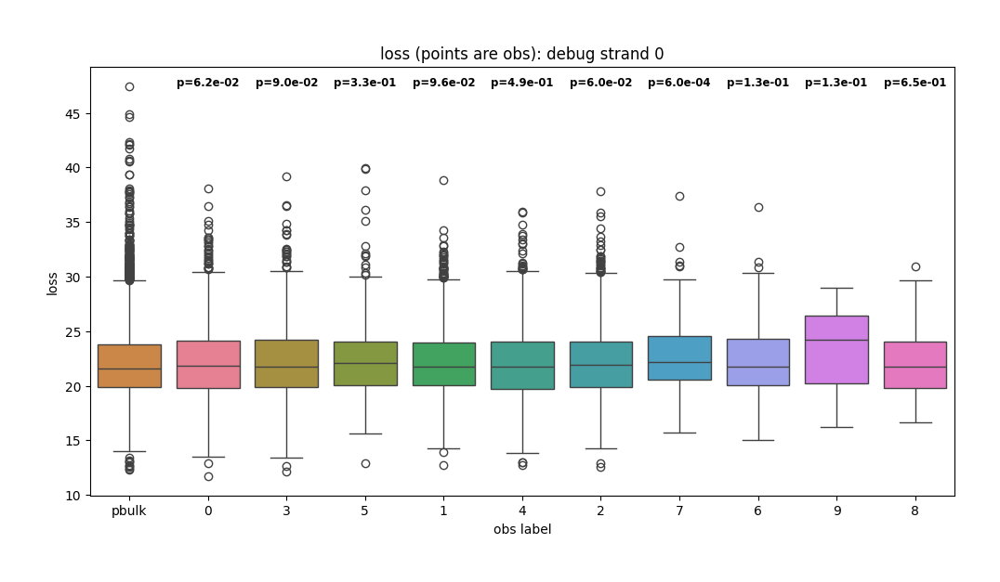

Mann-Whitney U test pbulk vs 0: U-statistic=3359219.5, p-value=3.018e-96
Mann-Whitney U test pbulk vs 3: U-statistic=2269328.0, p-value=4.771e-90
Mann-Whitney U test pbulk vs 5: U-statistic=494141.0, p-value=1.222e-19
Mann-Whitney U test pbulk vs 1: U-statistic=2915720.5, p-value=5.340e-91
Mann-Whitney U test pbulk vs 4: U-statistic=1626278.5, p-value=7.781e-48
Mann-Whitney U test pbulk vs 2: U-statistic=3020151.5, p-value=2.139e-78
Mann-Whitney U test pbulk vs 7: U-statistic=423427.0, p-value=5.128e-29
Mann-Whitney U test pbulk vs 6: U-statistic=562041.0, p-value=2.205e-15
Mann-Whitney U test pbulk vs 9: U-statistic=31798.0, p-value=1.303e-05
Mann-Whitney U test pbulk vs 8: U-statistic=78686.0, p-value=2.790e-04


<Figure size 640x480 with 0 Axes>

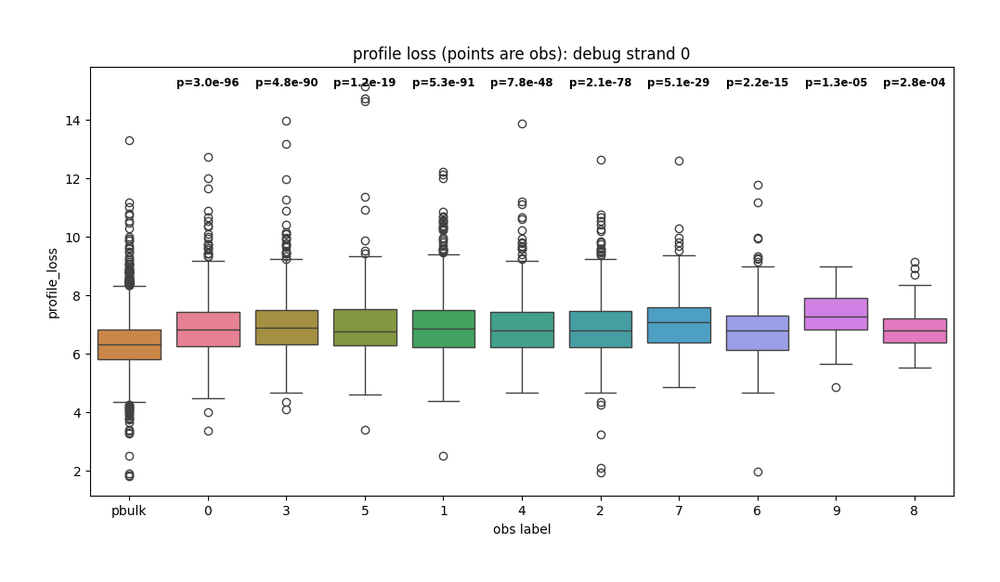

Mann-Whitney U test pbulk vs 0: U-statistic=10200711.0, p-value=0.000e+00
Mann-Whitney U test pbulk vs 3: U-statistic=7311200.0, p-value=0.000e+00
Mann-Whitney U test pbulk vs 5: U-statistic=1518321.0, p-value=1.337e-141
Mann-Whitney U test pbulk vs 1: U-statistic=8968332.0, p-value=0.000e+00
Mann-Whitney U test pbulk vs 4: U-statistic=4843025.0, p-value=0.000e+00
Mann-Whitney U test pbulk vs 2: U-statistic=8942835.0, p-value=0.000e+00
Mann-Whitney U test pbulk vs 7: U-statistic=1506613.0, p-value=6.295e-143
Mann-Whitney U test pbulk vs 6: U-statistic=1607965.0, p-value=3.265e-152
Mann-Whitney U test pbulk vs 9: U-statistic=141290.0, p-value=2.471e-15
Mann-Whitney U test pbulk vs 8: U-statistic=242278.0, p-value=3.870e-25


<Figure size 640x480 with 0 Axes>

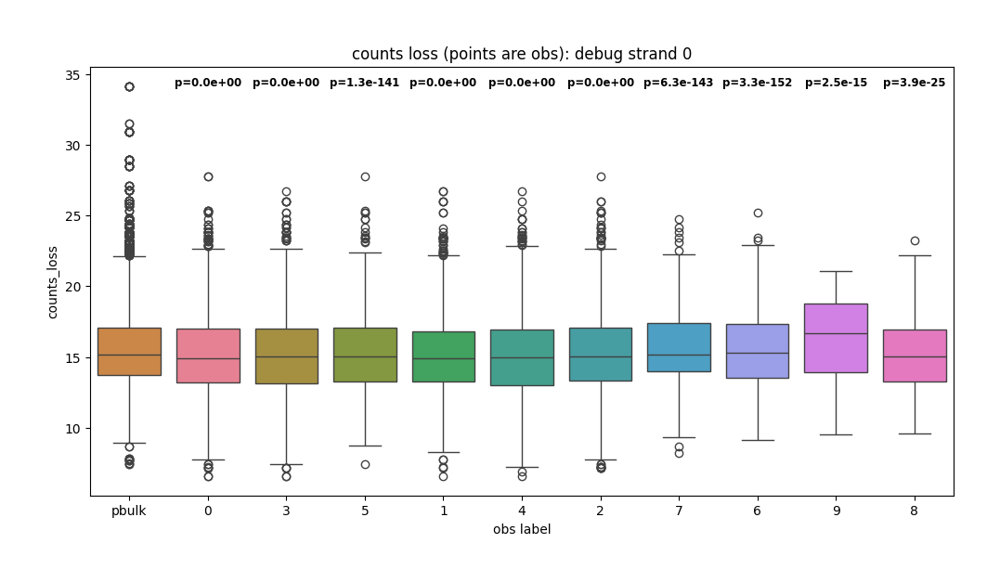

<Figure size 640x480 with 0 Axes>

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import mannwhitneyu
from collections import defaultdict

# Assuming df_val and run_config are already defined

all_profile_loss = []
all_counts_loss = []
all_labels = []

for row in df_val.iterrows():
    all_profile_loss.append(np.log1p(row[1]['profile_loss']))
    all_counts_loss.append(np.log1p(row[1]['count_loss']))
    all_labels.append(str(row[1]['obs_label']))
    all_profile_loss.append(np.log1p(row[1]['pbulk_profile_loss']))
    all_counts_loss.append(np.log1p(row[1]['pbulk_count_loss']))
    all_labels.append('pbulk')


combined_loss = [profile + run_config['counts_alpha'] * counts for profile, counts in zip(all_profile_loss, all_counts_loss)]

df = pd.DataFrame({'profile_loss': all_profile_loss,'counts_loss': all_counts_loss, 'loss': combined_loss, 'type': all_labels})

df = df[(df['profile_loss'] > 0) & (df['counts_loss'] > 0)]

# Create a color palette with unique colors for each 'type'
unique_types = df['type'].unique()
palette = sns.color_palette("husl", len(unique_types))

# Create a dictionary to map each 'type' to a specific color
type_colors = dict(zip(unique_types, palette))
type_order = ['pbulk'] + [t for t in df['type'].unique() if t != 'pbulk']

df['type'] = pd.Categorical(df['type'], categories=type_order, ordered=True)

# Isolate the 'pbulk' group
pbulk_group = df[df['type'] == 'pbulk']['loss']

# Perform pairwise Mann-Whitney U tests and store results
results = {}
for t in unique_types:
    if t != 'pbulk':
        group = df[df['type'] == t]['loss']
        stat, p_value = mannwhitneyu(pbulk_group, group)
        results[t] = (stat, p_value)
        print(f'Mann-Whitney U test pbulk vs {t}: U-statistic={stat}, p-value={p_value:.3e}')

# Create the box plot with colored columns
plt.figure(figsize=(12, 6))
sns.boxplot(x='type', y='loss', data=df, palette=type_colors)
plt.xlabel('obs label')
plt.ylabel('loss')
plt.title(f"loss (points are obs): debug strand {run_config['debug_strand']}")

# Annotate the plot with p-values
for i, (t, (stat, p_value)) in enumerate(results.items()):
    plt.text(i + 1, df['loss'].max(), f'p={p_value:.1e}', horizontalalignment='center', size='small', color='black', weight='semibold')

plt.show()
plt.savefig(f"{save_dir}/loss_obs_chr5.pdf")

# Isolate the 'pbulk' group
pbulk_group = df[df['type'] == 'pbulk']['profile_loss']

# Perform pairwise Mann-Whitney U tests and store results
results = {}
for t in unique_types:
    if t != 'pbulk':
        group = df[df['type'] == t]['profile_loss']
        stat, p_value = mannwhitneyu(pbulk_group, group)
        results[t] = (stat, p_value)
        print(f'Mann-Whitney U test pbulk vs {t}: U-statistic={stat}, p-value={p_value:.3e}')

# Create the box plot with colored columns
plt.figure(figsize=(12, 6))
sns.boxplot(x='type', y='profile_loss', data=df, palette=type_colors)
plt.xlabel('obs label')
plt.ylabel('profile_loss')
plt.title(f"profile loss (points are obs): debug strand {run_config['debug_strand']}")

# Annotate the plot with p-values
for i, (t, (stat, p_value)) in enumerate(results.items()):
    plt.text(i + 1, df['profile_loss'].max(), f'p={p_value:.1e}', horizontalalignment='center', size='small', color='black', weight='semibold')

plt.show()
plt.savefig(f"{save_dir}/profile_loss_obs_chr5.pdf")

# Isolate the 'pbulk' group
pbulk_group = df[df['type'] == 'pbulk']['counts_loss']

# Perform pairwise Mann-Whitney U tests and store results
results = {}
for t in unique_types:
    if t != 'pbulk':
        group = df[df['type'] == t]['profile_loss']
        stat, p_value = mannwhitneyu(pbulk_group, group)
        results[t] = (stat, p_value)
        print(f'Mann-Whitney U test pbulk vs {t}: U-statistic={stat}, p-value={p_value:.3e}')

# Create the box plot with colored columns
plt.figure(figsize=(12, 6))
sns.boxplot(x='type', y='counts_loss', data=df, palette=type_colors)
plt.xlabel('obs label')
plt.ylabel('counts_loss')
plt.title(f"counts loss (points are obs): debug strand {run_config['debug_strand']}")

# Annotate the plot with p-values
for i, (t, (stat, p_value)) in enumerate(results.items()):
    plt.text(i + 1, df['counts_loss'].max(), f'p={p_value:.1e}', horizontalalignment='center', size='small', color='black', weight='semibold')

plt.show()
plt.savefig(f"{save_dir}/counts_loss_obs_chr5.pdf")

Mann-Whitney U test pbulk vs 0: U-statistic=2237577.0, p-value=1.802e-256
Mann-Whitney U test pbulk vs 3: U-statistic=1576713.0, p-value=1.027e-199
Mann-Whitney U test pbulk vs 5: U-statistic=364179.0, p-value=3.903e-41
Mann-Whitney U test pbulk vs 1: U-statistic=1729419.0, p-value=4.189e-276
Mann-Whitney U test pbulk vs 4: U-statistic=1016063.0, p-value=4.013e-145
Mann-Whitney U test pbulk vs 2: U-statistic=2001424.0, p-value=4.362e-223
Mann-Whitney U test pbulk vs 7: U-statistic=311867.0, p-value=1.495e-50
Mann-Whitney U test pbulk vs 6: U-statistic=314970.0, p-value=1.085e-57
Mann-Whitney U test pbulk vs 9: U-statistic=34711.0, p-value=5.508e-05
Mann-Whitney U test pbulk vs 8: U-statistic=45058.0, p-value=7.509e-11


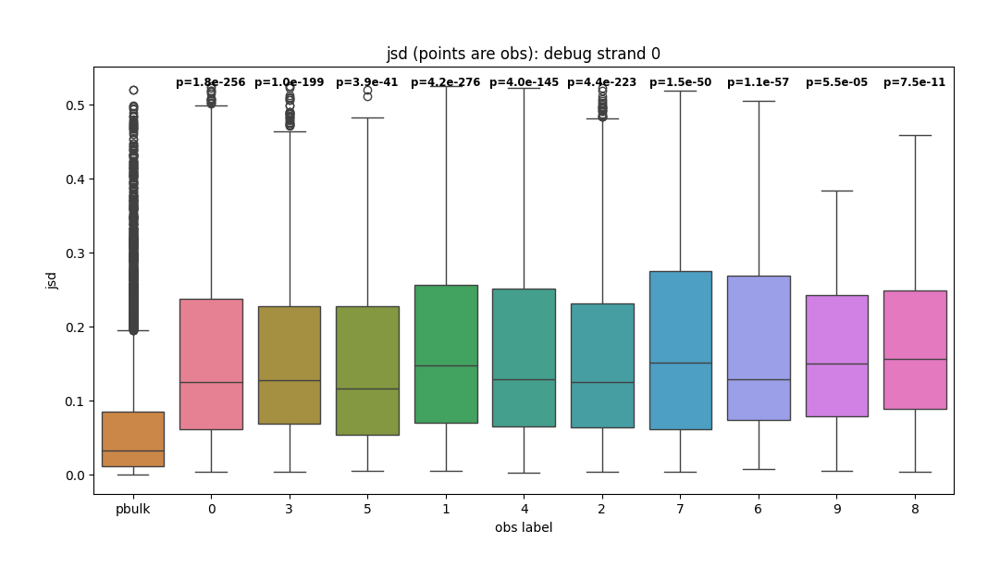

<Figure size 640x480 with 0 Axes>

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import mannwhitneyu
from collections import defaultdict

# Assuming df_val and run_config are already defined

all_jsd = []
all_labels_jsd = []

for row in df_val.iterrows():
    all_jsd.append(np.log1p(row[1]['profile_div']))
    all_labels_jsd.append(str(row[1]['obs_label']))
    all_jsd.append(np.log1p(row[1]['pbulk_profile_div']))
    all_labels_jsd.append('pbulk')
    
df = pd.DataFrame({'jsd': all_jsd, 'type': all_labels_jsd})

df = df[df['jsd'] > 0]

# Create a color palette with unique colors for each 'type'
unique_types = df['type'].unique()
palette = sns.color_palette("husl", len(unique_types))

# Create a dictionary to map each 'type' to a specific color
type_colors = dict(zip(unique_types, palette))
type_order = ['pbulk'] + [t for t in df['type'].unique() if t != 'pbulk']

df['type'] = pd.Categorical(df['type'], categories=type_order, ordered=True)

# Isolate the 'pbulk' group
pbulk_group = df[df['type'] == 'pbulk']['jsd']

# Perform pairwise Mann-Whitney U tests and store results
results = {}
for t in unique_types:
    if t != 'pbulk':
        group = df[df['type'] == t]['jsd']
        stat, p_value = mannwhitneyu(pbulk_group, group)
        results[t] = (stat, p_value)
        print(f'Mann-Whitney U test pbulk vs {t}: U-statistic={stat}, p-value={p_value:.3e}')

# Create the box plot with colored columns
plt.figure(figsize=(12, 6))
sns.boxplot(x='type', y='jsd', data=df, palette=type_colors)
plt.xlabel('obs label')
plt.ylabel('jsd')
plt.title(f"jsd (points are obs): debug strand {run_config['debug_strand']}")

# Annotate the plot with p-values
for i, (t, (stat, p_value)) in enumerate(results.items()):
    plt.text(i + 1, df['jsd'].max(), f'p={p_value:.1e}', horizontalalignment='center', size='small', color='black', weight='semibold')

plt.show()
plt.savefig(f"{save_dir}/jsd_obs_chr5.pdf")